In [93]:
import pandas as pd
import numpy as np
# from ydata_profiling import ProfileReport
import matplotlib.pyplot as plt
import plotly.express as px

import seaborn as sns
from surprise import SVD
from surprise.model_selection import cross_validate
from surprise.model_selection import train_test_split

from surprise import SVD, Dataset, Reader, accuracy
from surprise.model_selection import train_test_split
from surprise import BaselineOnly

from surprise.model_selection import GridSearchCV

from sklearn.metrics.pairwise import cosine_similarity
from scipy.sparse import csr_matrix
from surprise import accuracy

import pickle

rs=42

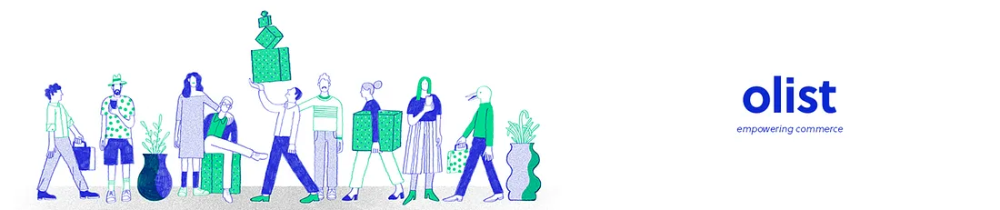

<img src="olist.png" alt="OLIST" style="width:100%; height:auto;">

<h2 style='text-align:center;'><b> Olist E-Commerce RFM Customer Segmentation and Recommendation System</b></h1>
<h5 style="text-align: center;">Alpha Team JCDS</h2>
<h5 style="text-align: center;">Tiara Cahyadi - 2604 - 005</h2>
<h5 style="text-align: center;">Muhammad Satria Yudha Mahendra - 2604 - 018 </h2>
<h5 style="text-align: center;">Ardi Arunaditya - 2604 - 021 </h2>


---

**Table of Contents**: 

1. [Business Problem](#1-Business-Problem)
    * [Business Context](#11-business-context)
    * [Business Problem](#12-business-problem)
    * [Objective](#13-objective)
    * [Analytic Approach](#15-analytic-approach)
2. [Data Understanding](#2-data-understanding)
3. [Data Cleaning and Preprocessing](#3-data-cleaning--preprocessing)
4. [Modeling](#4-model-selection)
5. [Conclusion and Recommendation](#5-conclusion-and-recommendation)

# **1. Business Problem**

## **1.1 Business Context**

In 2019, Olist, a major player in Brazil’s e-commerce marketplace, faced a critical challenge: customer retention was alarmingly low. A data-driven analysis revealed that over 90% of customers purchased only once, indicating that Olist struggles to retain customers beyond their first purchase.

At the same time, marketing costs were rising, forcing Olist to reassess its strategy. Acquiring a new customer costs approximately BRL 120 per customer, whereas retaining an existing customer costs only BRL 30 per customer. Despite this clear cost advantage, Olist’s previous generalized marketing strategies have failed to keep customers engaged, leading to an unsustainable reliance on customer acquisition.

Moreover, the Brazilian e-commerce sector is highly competitive, with major marketplaces like Mercado Livre, Americanas, and Magazine Luiza aggressively targeting customers with personalized experiences and loyalty programs. Olist, operating as a third-party seller marketplace, must compete not only in attracting new customers but also in retaining them for long-term revenue growth.

One of the most effective and easily implementable ways to understand customer behavior and improve retention is through RFM analysis (Recency, Frequency, Monetary).

By analyzing how recently and frequently customers make purchases, as well as how much they spend, Olist can segment its customers and implement personalized marketing strategies to encourage repeat purchases.


A targeted customer retention strategy can significantly impact Olist’s bottom line by leveraging:

- RFM (Recency, Frequency, Monetary) analysis to identify customer segments and personalize marketing.
- A recommendation system to provide tailored product suggestions, increasing repeat purchases.

Why is Customer Segmentation Important?

By understanding customer behavior through segmentation, Olist can:
- Helps personalize promotions for different customer groups.
- Can be used to develop loyalty programs and upsell/cross-sell campaigns.
- Helps identify high-value customers and loyal customers


By shifting from a generalized marketing approach to a customer-centric strategy, Olist can improve retention, optimize marketing spend, and drive long-term business growth in Brazil’s competitive e-commerce landscape.

## **1.2 Business Problem**

To address the issue, the Head of Marketing of Olist e-commerce has initiated a project aimed at retaining a long - term revenue growth and increasing customer retention through targeted marketing campaigns and recommendation systems.

**Stakeholder: Head of Marketing (Chief Marketing Officer - CMO)**


### **1.2.1 Problem Statement for Analytics**

How can we leverage RFM segmentation to classify customer into retenti-focused groups, enabling Olist to implement targeted marketing strategies to improve customer retention and increase revenue? 

### **1.2.2 Problem Statement for Machine Learning:** 


How can we develop a data-driven recommendation system that personalizes product suggestions based on customer behavior of Olist?

## **1.3 Objective**

- **Goals Analytics** : Classify customers into retention-focused groups using RFM segmentation for targeted marketing and analyze the revenue growth.
- **Goals Machine Learning** : Develop a recommendation system that personalizes product suggestions based on customer behavior to increase retention for Olist.

## **1.4 Analytic Approach**

1. Define the business context and problem
2. Data Understanding
    - What are the datasets being used
    - Features in the data
3. Data Cleaning and preprocessing
    - Clean the data
    - Feature engineering
4. Exploratory Data Analysis
    - Univariate
    - bivariate and multivariate analysis
5. RFM Analysis
6. Recommendation System
    - Similiraty Based Method
    - Model Based Method
    - Saving Model and Deployment
7. Conclusion and Recommendation

The process are:
1. **Data Analysis and Feature Selection**:
   - Analyze the dataset and feature to gain insights.
   - Use Recency, Frequency, and Monetary (RFM) analysis.

2. **Model Development**:
   - Apply Recommendation System to find the similar item and/or user to increase retention rate
   - Use Similarity Based Method and Model Based Method

3. **Optimization**:
   - Evaluate model using RMSE, MAE and adjust using hyperparameter tuning 

4. **Implementation**:
   - Using the segmentation results to create data-driven marketing strategies. 

This project aims to develop a customer segmentation model that helps Olist personalize marketing campaigns based on customer behavior and improve customer retention by targeting at risk customers while also increasing revenue.



# **2. Data Understanding**

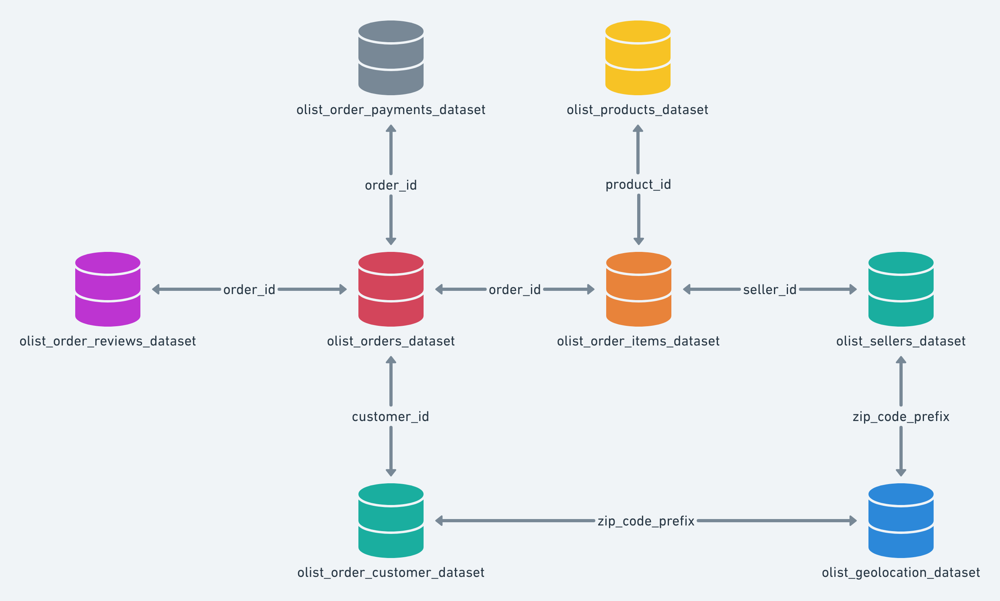

This dataset belongs to Olist, an e-commerce company.

Limitation :
* The available data is complete only up to August 2018, meaning analyses are limited to transactions and customer behavior within the period from 2017 to August 2018.

## **2.1 Dataset**

> Load Data

In [2]:
customer= pd.read_csv("olist_customers_dataset.csv")
geolocation = pd.read_csv("olist_geolocation_dataset.csv")
orderitems = pd.read_csv("olist_order_items_dataset.csv")
orderpayments = pd.read_csv("olist_order_payments_dataset.csv")
orderreview = pd.read_csv("olist_order_reviews_dataset.csv")
orderdataset = pd.read_csv("olist_orders_dataset.csv")
productdataset = pd.read_csv("olist_products_dataset.csv")
sellersdataset = pd.read_csv("olist_sellers_dataset.csv")
producttranslation= pd.read_csv("product_category_name_translation.csv")

### **2.1.1 Customer Dataset**

This dataset has information about the customer and its location. Use it to identify unique customers in the orders dataset and to find the orders delivery location.

At our system each order is assigned to a unique customer_id. This means that the same customer will get different ids for different orders. The purpose of having a customer_unique_id on the dataset is to allow you to identify customers that made repurchases at the store. Otherwise you would find that each order had a different customer associated with.

In [3]:
customer.sample(3)

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
19573,36500dcb80b06ffd0380d889580b0071,a8c78f8c4faf800e1d0c164deda39157,13091,campinas,SP
70054,63d14a19ab8e783063d0133f2bfd2fa6,d403b08458e8dacf5049334ed0222826,74823,goiania,GO
32859,aa5ca611bf23e034bfd48685d4fe006f,3eadc791253552b8fd96e5f63b403c8f,31060,belo horizonte,MG


In [4]:
customer.dtypes

customer_id                 object
customer_unique_id          object
customer_zip_code_prefix     int64
customer_city               object
customer_state              object
dtype: object

| Attribute | Data Type | Description |
| -- | -- | -- |
| customer_id | object |key to the orders dataset (each order has a unique customer_id)|
| customer_unique_id | object | unique identifier of a customer |
| customer_zip_code_prefix | int64 | first five digits of customer zip code|
| customer_city | object | customer city name |
| customer_state | object | customer state |

### **2.1.2 Order Items Dataset**

This dataset includes data about the items purchased within each order.

**Example**: <br>

The order_id = 00143d0f86d6fbd9f9b38ab440ac16f5 has 3 items (same product). Each item has the freight calculated accordingly to its measures and weight. To get the total freight value for each order you just have to sum.

The total order_item value is: 21.33 * 3 = 63.99

The total freight value is: 15.10 * 3 = 45.30

The total order value (product + freight) is: 45.30 + 63.99 = 109.29

In [5]:
orderitems.sample(3)

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value
16391,2583425d8fd6d2a22d92c8480c1b546d,1,b532349fe46b38fbc7bb3914c1bdae07,1025f0e2d44d7041d6cf58b6550e0bfa,2018-04-26 20:30:37,35.0,17.97
106989,f321507959f5d110b06985b282a5ea6e,1,b99e384e6e039ba6d828b4b0389ce91b,96493fab2fbb13a14d0c0e8772eef5c3,2017-06-07 13:10:36,589.0,19.88
52727,77fd1bb7a079c323766c396f21602228,1,54d9ac713e253fa1fae9c8003b011c2a,955fee9216a65b617aa5c0531780ce60,2018-01-12 09:10:28,29.5,13.08


In [6]:
orderitems.dtypes

order_id                object
order_item_id            int64
product_id              object
seller_id               object
shipping_limit_date     object
price                  float64
freight_value          float64
dtype: object

We will convert all timestamp data types into datetime type.

In [7]:
orderitems["shipping_limit_date"] = pd.to_datetime(orderitems["shipping_limit_date"])

| Attribute | Data Type | Description |
| -- | -- | -- |
| order_id | object | unique identifier of an order |
| order_item_id | int64 | sequential number identifying number of items included in the same order |
| product_id | object | unique identifier of a product |
| seller_id | object | unique identifier of a seller |
| shipping_limit_date | datetime64 | shows the seller shipping limit date for handling the order over to the logistic partner (given by olist) |
| price | float64 | item price |
| freight_value | float64 | item freight value (if an order has more than one item, the freight value is split between items) |

### **2.1.3 Order Payments Dataset**

This dataset includes data about the orders payment options

In [8]:
orderpayments.sample(3)

,order_id,payment_sequential,payment_type,payment_installments,payment_value
59694,8736bdf66d2a95b749c3fb6c3108f819,1,boleto,1,33.25
57984,81134c0da031fc1208ab4376cb3f384a,1,credit_card,1,29.41
11003,95886fbb27fa9240539af22614117003,1,voucher,1,207.57


In [9]:
orderpayments.dtypes

order_id                 object
payment_sequential        int64
payment_type             object
payment_installments      int64
payment_value           float64
dtype: object

| Attribute | Data Type | Description |
| -- | -- | -- |
| order_id | object | unique identifier of an order |
| payment_sequential | int64 | a customer may pay an order with more than one payment method. If he does so, a sequence will be created to accommodate all payments |
| payment_type | object | method of payment chosen by the customer |
| payment_installments | int64 | number of installments chosen by the customer |
| payment_value | float64 | transaction value |

### **2.1.4 Order Review Dataset**

This dataset includes data about the reviews made by the customers.

After a customer purchases the product from Olist Store a seller gets notified to fulfill that order. Once the customer receives the product, or the estimated delivery date is due, the customer gets a satisfaction survey by email where he can give a note for the purchase experience and write down some comments.

In [10]:
orderreview.sample(3)

,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
60292,ae4a8230dbe4572393b3c75af3ad7998,f02e9da25eaf6d8b85952d339283e40e,4,NaN,NaN,2017-05-20 00:00:00,2017-05-22 11:40:09
45090,59a7a373d8dd68c2293114b470ecb46d,3ca7b3fb51ca030ccab5b14f9b68cbf7,3,NaN,O produto veio de acordo com o descrito no anú...,2018-02-09 00:00:00,2018-02-10 12:41:55
55646,add4ba344a897402bb6d5c3844230c4d,e11c0a03163b8110243cfb64df2b07d4,5,NaN,Produto entregue no prazo,2017-10-01 00:00:00,2017-10-02 19:35:21


In [11]:
orderreview.dtypes

review_id                  object
order_id                   object
review_score                int64
review_comment_title       object
review_comment_message     object
review_creation_date       object
review_answer_timestamp    object
dtype: object

In [12]:
orderreview['review_creation_date']=pd.to_datetime(orderreview['review_creation_date'])
orderreview['review_answer_timestamp']=pd.to_datetime(orderreview['review_answer_timestamp'])

| Attribute | Data Type | Description |
| -- | -- | -- |
| review_id | object | unique identifier of a review |
| order_id | object | unique identifier of an order |
| review_score | int64 | score given by the customer on a satisfaction survey with scale from 1 to 5 |
| review_comment_title | object | comment title of the review left by the customer (in Portuguese) |
| review_comment_message | object | comment message left by the customer (in Portuguese) |
| review_creation_date | datetime64 | date when the satisfaction survey was sent to the customer |
| review_answer_timestamp | datetime64 | satisfaction survey answer timestamp |

### **2.1.5 Order Dataset** 

This is the core dataset. From each order you might find all other information.

In [13]:
orderdataset.sample(3)

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
847,14986dd5b5dc6b4203bda6666311e4d0,93f0c8eaf1b7a1c951d234d56b232e35,delivered,2018-08-25 22:17:18,2018-08-25 22:30:10,2018-08-27 10:46:00,2018-08-28 15:11:50,2018-09-20 00:00:00
1659,8c98f0aff69a4ac8620e15058c497092,0b706fbffec4cc332af5995e683ba779,delivered,2018-06-13 22:04:23,2018-06-13 22:38:47,2018-06-14 12:49:00,2018-06-25 17:13:28,2018-07-05 00:00:00
63031,98d24b150d7625f287efd12c0dcbadef,89e5d8080ba777e70327f8a5538f4388,delivered,2017-09-28 23:57:50,2017-09-29 00:28:18,2017-09-29 16:14:04,2017-10-04 21:07:34,2017-10-20 00:00:00


In [14]:
orderdataset.dtypes

order_id                         object
customer_id                      object
order_status                     object
order_purchase_timestamp         object
order_approved_at                object
order_delivered_carrier_date     object
order_delivered_customer_date    object
order_estimated_delivery_date    object
dtype: object

In [15]:
orderdataset['order_purchase_timestamp'] = pd.to_datetime(orderdataset['order_purchase_timestamp'])
orderdataset['order_approved_at'] = pd.to_datetime(orderdataset['order_approved_at'])
orderdataset['order_delivered_carrier_date'] = pd.to_datetime(orderdataset['order_delivered_carrier_date'])
orderdataset['order_delivered_customer_date'] = pd.to_datetime(orderdataset['order_delivered_customer_date'])
orderdataset['order_estimated_delivery_date'] = pd.to_datetime(orderdataset['order_estimated_delivery_date'])

| Attribute | Data Type | Description |
| -- | -- | -- |
| order_id | object | unique identifier of an order |
| customer_id | object | key to the customers dataset, each order has a unique customer_id |
| order_status | object | reference to the order status |
| order_purchase_timestamp | datetime64 | shows the purchase timestamp |
| order_approved_at | datetime64 | shows the payment approval timestamp |
| order_delivered_carrier_date | datetime64 | shows the order posting timestamp. When it was handled to the logistic partner |
| order_delivered_customer_date | datetime64 | shows the actual order delivery date to the customer |
| order_estimated_delivery_date | datetime64 | shows the estimated delivery date that was informed to the customer at the purchase moment |

### **2.1.6 Product Dataset** 

This dataset includes data about the products sold by Olist.

In [16]:
productdataset.sample(3)

,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
14086,dad27486af34282fef3bef995d0fda7b,cool_stuff,33.0,604.0,1.0,2050.0,42.0,25.0,15.0
21953,1a7e98c48e146130016fab89a43c00da,cama_mesa_banho,56.0,230.0,1.0,2000.0,36.0,8.0,27.0
18694,591d4f16311726b70ab348c9e3c49a33,cama_mesa_banho,46.0,171.0,3.0,12000.0,60.0,30.0,70.0


In [17]:
productdataset.dtypes

product_id                     object
product_category_name          object
product_name_lenght           float64
product_description_lenght    float64
product_photos_qty            float64
product_weight_g              float64
product_length_cm             float64
product_height_cm             float64
product_width_cm              float64
dtype: object

| Attribute | Data Type | Description |
| -- | -- | -- |
| product_id | object | unique identifier of a product |
| product_category_name | object | root category of the product, in Portuguese |
| product_name_length | float64 | number of characters extracted from the product name |
| product_description_length | float64 | number of characters extracted from the product description |
| product_photos_qty | float64 | number of product published photos |
| product_weight_g | float64 | product weight measured in grams |
| product_length_cm | float64 | product length measured in centimeters |
| product_height_cm | float64 | product height measured in centimeters |
| product_width_cm | float64 | product width measured in centimeters |

### **2.1.7 Product Category Translation Dataset**

Translates the product_category_name to english.

In [18]:
producttranslation.sample(3)

,product_category_name,product_category_name_english
13,tablets_impressao_imagem,tablets_printing_image
53,pcs,computers
46,artes,art


In [19]:
producttranslation.dtypes

product_category_name            object
product_category_name_english    object
dtype: object

| Attribute | Data Type | Description |
| -- | -- | -- |
| product_category_name | object | category name in Portuguese |
| product_category_name_english | object | category name in English |

# **3. Data Cleaning & Preprocessing**

As we need to merge the datasets into one but we cannot do that without  identify each of the dataset. This process is needed to make sure that our data is correct. We will further analyze each dataset.

## **3.1 Skimming Each Dataset**

In [20]:
# Define datasets and their titles
datasets = [customer, geolocation, orderitems, orderpayments, orderreview, orderdataset, productdataset, sellersdataset, producttranslation]
titles = ["customer", "geolocation", "orderitems", "orderpayments", "orderreview", "orderdataset", "productdataset", "sellersdataset", "producttranslation"]

# Create a summary dataframe
data_summary = pd.DataFrame()
data_summary['datasets'] = titles
data_summary['columns'] = [', '.join(data.columns) for data in datasets]
data_summary['total_rows'] = [data.shape[0] for data in datasets]
data_summary['total_cols'] = [data.shape[1] for data in datasets]
data_summary['total_duplicate'] = [data.duplicated().sum() for data in datasets]
data_summary['total_null'] = [data.isnull().sum().sum() for data in datasets]
data_summary['null_cols'] = [', '.join([col for col in data.columns if data[col].isnull().sum() > 0]) for data in datasets]
data_summary.style.background_gradient(cmap='YlGnBu')  # Adds color gradient for better visualization

,datasets,columns,total_rows,total_cols,total_duplicate,total_null,null_cols
0,customer,"customer_id, customer_unique_id, customer_zip_code_prefix, customer_city, customer_state",99441,5,0,0,
1,geolocation,"geolocation_zip_code_prefix, geolocation_lat, geolocation_lng, geolocation_city, geolocation_state",1000163,5,261831,0,
2,orderitems,"order_id, order_item_id, product_id, seller_id, shipping_limit_date, price, freight_value",112650,7,0,0,
3,orderpayments,"order_id, payment_sequential, payment_type, payment_installments, payment_value",103886,5,0,0,
4,orderreview,"review_id, order_id, review_score, review_comment_title, review_comment_message, review_creation_date, review_answer_timestamp",99224,7,0,145903,"review_comment_title, review_comment_message"
5,orderdataset,"order_id, customer_id, order_status, order_purchase_timestamp, order_approved_at, order_delivered_carrier_date, order_delivered_customer_date, order_estimated_delivery_date",99441,8,0,4908,"order_approved_at, order_delivered_carrier_date, order_delivered_customer_date"
6,productdataset,"product_id, product_category_name, product_name_lenght, product_description_lenght, product_photos_qty, product_weight_g, product_length_cm, product_height_cm, product_width_cm",32951,9,0,2448,"product_category_name, product_name_lenght, product_description_lenght, product_photos_qty, product_weight_g, product_length_cm, product_height_cm, product_width_cm"
7,sellersdataset,"seller_id, seller_zip_code_prefix, seller_city, seller_state",3095,4,0,0,
8,producttranslation,"product_category_name, product_category_name_english",71,2,0,0,


## **3.2 Data Duplicate**

Let's drop the duplicate

In [21]:
duplicates = geolocation[geolocation.duplicated()]
duplicates

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
15,1046,-23.546081,-46.644820,sao paulo,SP
44,1046,-23.546081,-46.644820,sao paulo,SP
65,1046,-23.546081,-46.644820,sao paulo,SP
66,1009,-23.546935,-46.636588,sao paulo,SP
67,1046,-23.546081,-46.644820,sao paulo,SP
...,...,...,...,...,...
1000153,99970,-28.343273,-51.873734,ciriaco,RS
1000154,99950,-28.070493,-52.011342,tapejara,RS
1000159,99900,-27.877125,-52.224882,getulio vargas,RS
1000160,99950,-28.071855,-52.014716,tapejara,RS


In [22]:
geolocation = geolocation.drop_duplicates()

In [23]:
# Define datasets and their titles
datasets = [customer, geolocation, orderitems, orderpayments, orderreview, orderdataset, productdataset, sellersdataset, producttranslation]
titles = ["customer", "geolocation", "orderitems", "orderpayments", "orderreview", "orderdataset", "productdataset", "sellersdataset", "producttranslation"]

# Create a summary dataframe
data_summary = pd.DataFrame()
data_summary['datasets'] = titles
data_summary['columns'] = [', '.join(data.columns) for data in datasets]
data_summary['total_rows'] = [data.shape[0] for data in datasets]
data_summary['total_cols'] = [data.shape[1] for data in datasets]
data_summary['total_duplicate'] = [data.duplicated().sum() for data in datasets]
data_summary['total_null'] = [data.isnull().sum().sum() for data in datasets]
data_summary['null_cols'] = [', '.join([col for col in data.columns if data[col].isnull().sum() > 0]) for data in datasets]
data_summary.style.background_gradient(cmap='YlGnBu')  # darker = higher values for each column
# data_summary

,datasets,columns,total_rows,total_cols,total_duplicate,total_null,null_cols
0,customer,"customer_id, customer_unique_id, customer_zip_code_prefix, customer_city, customer_state",99441,5,0,0,
1,geolocation,"geolocation_zip_code_prefix, geolocation_lat, geolocation_lng, geolocation_city, geolocation_state",738332,5,0,0,
2,orderitems,"order_id, order_item_id, product_id, seller_id, shipping_limit_date, price, freight_value",112650,7,0,0,
3,orderpayments,"order_id, payment_sequential, payment_type, payment_installments, payment_value",103886,5,0,0,
4,orderreview,"review_id, order_id, review_score, review_comment_title, review_comment_message, review_creation_date, review_answer_timestamp",99224,7,0,145903,"review_comment_title, review_comment_message"
5,orderdataset,"order_id, customer_id, order_status, order_purchase_timestamp, order_approved_at, order_delivered_carrier_date, order_delivered_customer_date, order_estimated_delivery_date",99441,8,0,4908,"order_approved_at, order_delivered_carrier_date, order_delivered_customer_date"
6,productdataset,"product_id, product_category_name, product_name_lenght, product_description_lenght, product_photos_qty, product_weight_g, product_length_cm, product_height_cm, product_width_cm",32951,9,0,2448,"product_category_name, product_name_lenght, product_description_lenght, product_photos_qty, product_weight_g, product_length_cm, product_height_cm, product_width_cm"
7,sellersdataset,"seller_id, seller_zip_code_prefix, seller_city, seller_state",3095,4,0,0,
8,producttranslation,"product_category_name, product_category_name_english",71,2,0,0,


In [24]:
display(customer.columns,
        geolocation.columns,
        orderitems.columns,
        orderpayments.columns,
        orderreview.columns,
        orderdataset.columns,
        productdataset.columns,
        sellersdataset.columns,
        producttranslation.columns)

Index(['customer_id', 'customer_unique_id', 'customer_zip_code_prefix',
       'customer_city', 'customer_state'],
      dtype='object')

Index(['geolocation_zip_code_prefix', 'geolocation_lat', 'geolocation_lng',
       'geolocation_city', 'geolocation_state'],
      dtype='object')

Index(['order_id', 'order_item_id', 'product_id', 'seller_id',
       'shipping_limit_date', 'price', 'freight_value'],
      dtype='object')

Index(['order_id', 'payment_sequential', 'payment_type',
       'payment_installments', 'payment_value'],
      dtype='object')

Index(['review_id', 'order_id', 'review_score', 'review_comment_title',
       'review_comment_message', 'review_creation_date',
       'review_answer_timestamp'],
      dtype='object')

Index(['order_id', 'customer_id', 'order_status', 'order_purchase_timestamp',
       'order_approved_at', 'order_delivered_carrier_date',
       'order_delivered_customer_date', 'order_estimated_delivery_date'],
      dtype='object')

Index(['product_id', 'product_category_name', 'product_name_lenght',
       'product_description_lenght', 'product_photos_qty', 'product_weight_g',
       'product_length_cm', 'product_height_cm', 'product_width_cm'],
      dtype='object')

Index(['seller_id', 'seller_zip_code_prefix', 'seller_city', 'seller_state'], dtype='object')

Index(['product_category_name', 'product_category_name_english'], dtype='object')

In [25]:
datasets_orderid = [customer, orderdataset, orderitems, orderreview, orderpayments, productdataset, sellersdataset]
titles = ["customer", "orderdataset", "orderitems", "orderreview", "orderpayments", "productdataset","sellerdataset"]

# Create a dictionary to store the results
datasets_col_duplicates = []

# Loop through each dataset
for datasets_orderid, title in zip(datasets_orderid, titles):
    for col in datasets_orderid.columns:
        duplicate_count = datasets_orderid[col].duplicated().sum()
        datasets_col_duplicates.append({"Dataset": title, "Column": col, "Duplicate Count": duplicate_count})

# Convert the results into a DataFrame
datasets_col_duplicates = pd.DataFrame(datasets_col_duplicates)
datasets_col_duplicates.style.background_gradient(cmap='YlGnBu')  # darker = higher values for each column


,Dataset,Column,Duplicate Count
0,customer,customer_id,0
1,customer,customer_unique_id,3345
2,customer,customer_zip_code_prefix,84447
3,customer,customer_city,95322
4,customer,customer_state,99414
5,orderdataset,order_id,0
6,orderdataset,customer_id,0
7,orderdataset,order_status,99433
8,orderdataset,order_purchase_timestamp,566
9,orderdataset,order_approved_at,8707


## **3.3 Payment Dataset Feature Engineering**

Before merging, due to one order id could have different type of payment type, it could lead to duplicates and change the payment value of those items, so the order payments dataset needs to be restructure.

In [26]:
# orderpayments[orderpayments['payment_sequential']>=10]
orderpayments[orderpayments['order_id']=="3c58bffb70dcf45f12bdf66a3c215905"]

,order_id,payment_sequential,payment_type,payment_installments,payment_value
1587,3c58bffb70dcf45f12bdf66a3c215905,10,voucher,1,1.85
5918,3c58bffb70dcf45f12bdf66a3c215905,11,voucher,1,12.86
6279,3c58bffb70dcf45f12bdf66a3c215905,4,voucher,1,5.10
7198,3c58bffb70dcf45f12bdf66a3c215905,1,voucher,1,2.26
34519,3c58bffb70dcf45f12bdf66a3c215905,9,voucher,1,7.94
45812,3c58bffb70dcf45f12bdf66a3c215905,3,voucher,1,3.88
50303,3c58bffb70dcf45f12bdf66a3c215905,12,voucher,1,8.23
54641,3c58bffb70dcf45f12bdf66a3c215905,2,voucher,1,3.36
67382,3c58bffb70dcf45f12bdf66a3c215905,6,voucher,1,29.55
79714,3c58bffb70dcf45f12bdf66a3c215905,7,voucher,1,11.59


In [27]:
orderpayments['payment_type'].unique()

array(['credit_card', 'boleto', 'voucher', 'debit_card', 'not_defined'],
      dtype=object)

In [28]:
orderpayments["order_id"].describe()

count                               103886
unique                               99440
top       fa65dad1b0e818e3ccc5cb0e39231352
freq                                    29
Name: order_id, dtype: object

In [29]:
payment_max = orderpayments.groupby("order_id",as_index=False).agg({
    "payment_value": "sum",  # Sum total payment per order
    "payment_sequential": "max", #Max payment sequent
    "payment_installments": "max"   #Max installement
})

payment_max

,order_id,payment_value,payment_sequential,payment_installments
0,00010242fe8c5a6d1ba2dd792cb16214,72.19,1,2
1,00018f77f2f0320c557190d7a144bdd3,259.83,1,3
2,000229ec398224ef6ca0657da4fc703e,216.87,1,5
3,00024acbcdf0a6daa1e931b038114c75,25.78,1,2
4,00042b26cf59d7ce69dfabb4e55b4fd9,218.04,1,3
...,...,...,...,...
99435,fffc94f6ce00a00581880bf54a75a037,343.40,1,1
99436,fffcd46ef2263f404302a634eb57f7eb,386.53,1,1
99437,fffce4705a9662cd70adb13d4a31832d,116.85,1,3
99438,fffe18544ffabc95dfada21779c9644f,64.71,1,3


In [30]:
payment_type = pd.get_dummies(orderpayments[['order_id', 'payment_type']], columns=['payment_type'])
payment_type = payment_type.groupby("order_id", as_index=False).max()
payment_type.iloc[:, 1:] = payment_type.iloc[:, 1:].astype(int)  # Convert all columns except 'order_id'
payment_type


/var/folders/cr/hz35zl7n47s127kxhzszt_wc0000gn/T/ipykernel_92903/2646620344.py:3: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '0        0
1        0
2        0
3        0
4        0
        ..
99435    1
99436    1
99437    0
99438    0
99439    0
Name: payment_type_boleto, Length: 99440, dtype: int64' has dtype incompatible with bool, please explicitly cast to a compatible dtype first.
  payment_type.iloc[:, 1:] = payment_type.iloc[:, 1:].astype(int)  # Convert all columns except 'order_id'
/var/folders/cr/hz35zl7n47s127kxhzszt_wc0000gn/T/ipykernel_92903/2646620344.py:3: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '0        1
1        1
2        1
3        1
4        1
        ..
99435    0
99436    0
99437    1
99438    1
99439    1
Name: payment_type_credit_card, Length: 99440, dtype: int64' has dtype incompatible with bool, please explici

,order_id,payment_type_boleto,payment_type_credit_card,payment_type_debit_card,payment_type_not_defined,payment_type_voucher
0,00010242fe8c5a6d1ba2dd792cb16214,0,1,0,0,0
1,00018f77f2f0320c557190d7a144bdd3,0,1,0,0,0
2,000229ec398224ef6ca0657da4fc703e,0,1,0,0,0
3,00024acbcdf0a6daa1e931b038114c75,0,1,0,0,0
4,00042b26cf59d7ce69dfabb4e55b4fd9,0,1,0,0,0
...,...,...,...,...,...,...
99435,fffc94f6ce00a00581880bf54a75a037,1,0,0,0,0
99436,fffcd46ef2263f404302a634eb57f7eb,1,0,0,0,0
99437,fffce4705a9662cd70adb13d4a31832d,0,1,0,0,0
99438,fffe18544ffabc95dfada21779c9644f,0,1,0,0,0


In [31]:
# Merge payment_max and payment_type using order_id
paymentnew = payment_max.merge(payment_type, on="order_id", how="left")
paymentnew.head()

,order_id,payment_value,payment_sequential,payment_installments,payment_type_boleto,payment_type_credit_card,payment_type_debit_card,payment_type_not_defined,payment_type_voucher
0,00010242fe8c5a6d1ba2dd792cb16214,72.19,1,2,0,1,0,0,0
1,00018f77f2f0320c557190d7a144bdd3,259.83,1,3,0,1,0,0,0
2,000229ec398224ef6ca0657da4fc703e,216.87,1,5,0,1,0,0,0
3,00024acbcdf0a6daa1e931b038114c75,25.78,1,2,0,1,0,0,0
4,00042b26cf59d7ce69dfabb4e55b4fd9,218.04,1,3,0,1,0,0,0


Let's use 1 order id to check whether the merge and encoding works well.

In [32]:
orderpayments[orderpayments["payment_sequential"]>=10].head(1)

,order_id,payment_sequential,payment_type,payment_installments,payment_value
1587,3c58bffb70dcf45f12bdf66a3c215905,10,voucher,1,1.85


In [33]:
orderpayments[orderpayments["order_id"]=="3c58bffb70dcf45f12bdf66a3c215905"]

,order_id,payment_sequential,payment_type,payment_installments,payment_value
1587,3c58bffb70dcf45f12bdf66a3c215905,10,voucher,1,1.85
5918,3c58bffb70dcf45f12bdf66a3c215905,11,voucher,1,12.86
6279,3c58bffb70dcf45f12bdf66a3c215905,4,voucher,1,5.10
7198,3c58bffb70dcf45f12bdf66a3c215905,1,voucher,1,2.26
34519,3c58bffb70dcf45f12bdf66a3c215905,9,voucher,1,7.94
45812,3c58bffb70dcf45f12bdf66a3c215905,3,voucher,1,3.88
50303,3c58bffb70dcf45f12bdf66a3c215905,12,voucher,1,8.23
54641,3c58bffb70dcf45f12bdf66a3c215905,2,voucher,1,3.36
67382,3c58bffb70dcf45f12bdf66a3c215905,6,voucher,1,29.55
79714,3c58bffb70dcf45f12bdf66a3c215905,7,voucher,1,11.59


In [34]:
paymentnew[paymentnew["order_id"]=="3c58bffb70dcf45f12bdf66a3c215905"]

,order_id,payment_value,payment_sequential,payment_installments,payment_type_boleto,payment_type_credit_card,payment_type_debit_card,payment_type_not_defined,payment_type_voucher
23431,3c58bffb70dcf45f12bdf66a3c215905,100.57,14,1,0,0,0,0,1


The result is correct. We can continue to merge with the other dataset.

## **3.4 Merging Datasets**

In [35]:
df_merge = customer.merge(orderdataset, on="customer_id", how="inner")
df_merge = df_merge.merge(orderitems, on="order_id", how="inner")
df_merge = df_merge.merge(orderreview, on="order_id", how="inner")
df_merge = df_merge.merge(paymentnew, on="order_id", how="inner")
df_merge = df_merge.merge(productdataset, on="product_id", how="inner")
df_merge = df_merge.merge(producttranslation, on= 'product_category_name', how= "inner")

There are several column we will not be using because of its irrelevancy to the current analysis, which are : 

- review id
- review_comment_title
- review_comment_message
- review_creation_date
- review_answer_timestamp
- product_name_lenght
- product_description_lenght
- product_photos_qty
- product_weight_g
- product_length_cm
- product_height_cm
- product_width_cm

As the complete data is only up to August 2018, we will remove the data outside of this timeline.

In [36]:
columns_to_drop = ["review_id", "review_comment_title", "review_comment_message", "review_creation_date", 
                   "review_answer_timestamp", "product_name_lenght", "product_description_lenght",
                   "product_photos_qty", "product_weight_g", "product_length_cm",
                   "product_height_cm", "product_width_cm"]

df_merge = df_merge.drop(columns=columns_to_drop)

In [37]:
df_merge = df_merge[(df_merge['order_purchase_timestamp'].dt.year.isin([2017, 2018])) &
                    (df_merge['order_purchase_timestamp'] <= "2018-08-31")]
df_merge = df_merge[df_merge['shipping_limit_date'].dt.year.isin([2017, 2018])]

## **3.5 Handling Anomalies**

In [38]:
Counts = df_merge.isnull().sum()
Percentages = df_merge.isnull().sum() * 100 / len(df_merge)

null = pd.concat([Counts, Percentages], axis=1, keys=["Counts", "Percentages (%)"]).sort_values(by="Counts", ascending=False)
null= null[null["Counts"] > 0]
null

,Counts,Percentages (%)
order_delivered_customer_date,2245,2.033901
order_delivered_carrier_date,1107,1.002908
order_approved_at,14,0.012684


### **3.5.1 Missing value in `order_approved_at`**

In [39]:
df_merge[df_merge["order_approved_at"].isnull()]

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,...,payment_value,payment_sequential,payment_installments,payment_type_boleto,payment_type_credit_card,payment_type_debit_card,payment_type_not_defined,payment_type_voucher,product_category_name,product_category_name_english
10004,0bf35cac6cc7327065da879e2d90fae8,c4c0011e639bdbcf26059ddc38bd3c18,13225,varzea paulista,SP,d77031d6a3c8a52f019764e68f211c69,delivered,2017-02-18 11:04:19,NaT,2017-02-23 07:23:36,...,39.95,1,1,1,0,0,0,0,esporte_lazer,sports_leisure
15481,1e101e0daffaddce8159d25a8e53f2b2,c8822fce1d0bfa7ddf0da24fff947172,27945,macae,RJ,12a95a3c06dbaec84bcfb0e2da5d228a,delivered,2017-02-17 13:05:55,NaT,2017-02-22 11:23:11,...,95.76,1,1,1,0,0,0,0,cool_stuff,cool_stuff
23289,d5de688c321096d15508faae67a27051,d49f3dae6bad25d05160fc17aca5942d,36400,conselheiro lafaiete,MG,7002a78c79c519ac54022d4f8a65e6e8,delivered,2017-01-19 22:26:59,NaT,2017-01-27 11:08:05,...,60.42,1,1,1,0,0,0,0,moveis_decoracao,furniture_decor
25286,07a2a7e0f63fd8cb757ed77d4245623c,79af1bbf230a2630487975aa5d7d6220,37660,paraisopolis,MG,51eb2eebd5d76a24625b31c33dd41449,delivered,2017-02-18 15:52:27,NaT,2017-02-23 03:09:14,...,77.06,1,1,1,0,0,0,0,moveis_decoracao,furniture_decor
30516,68d081753ad4fe22fc4d410a9eb1ca01,2e0a2166aa23da2472c6a60c4af6f7a6,3573,sao paulo,SP,d69e5d356402adc8cf17e08b5033acfb,delivered,2017-02-19 01:28:47,NaT,2017-02-23 03:11:48,...,163.43,1,1,1,0,0,0,0,moveis_decoracao,furniture_decor
43702,d85919cb3c0529589c6fa617f5f43281,c094ac95fcd52f821809ec232a7a6956,95795,sao vendelino,RS,3c0b8706b065f9919d0505d3b3343881,delivered,2017-02-17 15:53:27,NaT,2017-02-22 11:31:30,...,157.19,1,1,1,0,0,0,0,cama_mesa_banho,bed_bath_table
46172,74bebaf46603f9340e3b50c6b086f992,f79be7c08dd24b72d34634f1b89333a4,65110,sao jose de ribamar,MA,2babbb4b15e6d2dfe95e2de765c97bce,delivered,2017-02-18 17:15:03,NaT,2017-02-22 11:23:11,...,106.81,1,1,1,0,0,0,0,cool_stuff,cool_stuff
49012,684cb238dc5b5d6366244e0e0776b450,6ff8b0d7b35d5c945633b8d60165691b,11030,santos,SP,c1d4211b3dae76144deccd6c74144a88,delivered,2017-01-19 12:48:08,NaT,2017-01-25 14:56:50,...,54.51,1,1,1,0,0,0,0,esporte_lazer,sports_leisure
58874,a3d3c38e58b9d2dfb9207cab690b6310,5a4fa4919cbf2b049e72be460a380e5b,35620,abaete,MG,2eecb0d85f281280f79fa00f9cec1a95,delivered,2017-02-17 17:21:55,NaT,2017-02-22 11:42:51,...,154.23,1,1,1,0,0,0,0,ferramentas_jardim,garden_tools
66831,2127dc6603ac33544953ef05ec155771,8a9a08c7ca8900a200d83cf838a07e0b,6708,cotia,SP,e04abd8149ef81b95221e88f6ed9ab6a,delivered,2017-02-18 14:40:00,NaT,2017-02-23 12:04:47,...,349.01,1,1,1,0,0,0,0,eletroportateis,small_appliances


As the amount is too small, it is likely caused by a data entry error. We will fill the missing values using the order approved time, based on the median time difference between order approval and order purchase in the dataset.

In [40]:
median_diff = (df_merge["order_approved_at"] - df_merge["order_purchase_timestamp"]).median()
median_diff

Timedelta('0 days 00:20:59')

In [41]:
# Fill missing values using the median difference
df_merge["order_approved_at"] = df_merge["order_approved_at"].fillna(df_merge["order_purchase_timestamp"] + median_diff)

In [42]:
df_merge[df_merge["order_approved_at"].isnull()]

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,...,payment_value,payment_sequential,payment_installments,payment_type_boleto,payment_type_credit_card,payment_type_debit_card,payment_type_not_defined,payment_type_voucher,product_category_name,product_category_name_english


### **3.5.2 Missing Value in `order_delivered_carrier_date` and `order_delivered_customer_date`**

In [43]:
df_merge[df_merge["order_delivered_carrier_date"].isnull()][["order_status","order_delivered_carrier_date","order_delivered_customer_date","order_estimated_delivery_date"]]

,order_status,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
48,invoiced,NaT,NaT,2018-05-24
143,invoiced,NaT,NaT,2017-09-15
275,processing,NaT,NaT,2018-01-05
417,canceled,NaT,NaT,2018-03-06
419,canceled,NaT,NaT,2017-06-30
...,...,...,...,...
110051,invoiced,NaT,NaT,2017-07-03
110096,processing,NaT,NaT,2017-06-21
110268,canceled,NaT,NaT,2017-11-27
110355,invoiced,NaT,NaT,2018-06-04


In [44]:
df_merge[df_merge["order_delivered_carrier_date"].isnull()]["order_status"].value_counts()

order_status
canceled      438
processing    337
invoiced      327
approved        3
delivered       2
Name: count, dtype: int64

In [45]:
df_merge[df_merge["order_delivered_customer_date"].isnull()]["order_status"].value_counts()

order_status
shipped       1074
canceled       496
processing     337
invoiced       327
delivered        8
approved         3
Name: count, dtype: int64

The missing value of the date is caused by the current condition of the dataset, where the package hasn't been completed and received by the customer. In order to do this analysis, we will fill the date with order estimated delivery date. 

In [46]:
df_merge["order_delivered_carrier_date"].fillna(df_merge["order_estimated_delivery_date"], inplace=True)
df_merge["order_delivered_customer_date"].fillna(df_merge["order_estimated_delivery_date"], inplace=True)

/var/folders/cr/hz35zl7n47s127kxhzszt_wc0000gn/T/ipykernel_92903/2291167956.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df_merge["order_delivered_carrier_date"].fillna(df_merge["order_estimated_delivery_date"], inplace=True)
/var/folders/cr/hz35zl7n47s127kxhzszt_wc0000gn/T/ipykernel_92903/2291167956.py:2: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the

### **3.5.3 Missing value in review_score**

In [47]:
df_merge[df_merge["review_score"].isnull()][["review_score","order_status","order_delivered_carrier_date","order_delivered_customer_date","order_estimated_delivery_date"]]

,review_score,order_status,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date


As this represents the real case where customer don't put any review. We will leave the data as it is for now.

### **3.5.4 Changing Product Category Name to English**

Because the english translation has already been merge with the dataset, we only need to drop the original product category name 

In [48]:
df_merge.drop(columns= ["product_category_name"], inplace = True)

Let's see the cleaned dataset to be used for further anlaysis.

In [49]:
list_item = []
for col in df_merge.columns:
    list_item.append([col, df_merge[col].dtype, len(df_merge), df_merge[col].isna().sum(), round((df_merge[col].isna().sum()/len(df_merge[col]))*100,3),
    df_merge[col].nunique(), df_merge[col].unique()])

df_items_info = pd.DataFrame(columns=['Column Name', 'Data Type', 'Data Count', 'Missing Value',
    'Missing Value %', 'Number of Unique', 'Unique Sample'],
    data = list_item)

df_items_info.sort_values(by=['Missing Value %'], ascending=False).reset_index(drop=True)

,Column Name,Data Type,Data Count,Missing Value,Missing Value %,Number of Unique,Unique Sample
0,customer_id,object,110379,0,0.0,96208,"[06b8999e2fba1a1fbc88172c00ba8bc7, 18955e83d33..."
1,customer_unique_id,object,110379,0,0.0,93103,"[861eff4711a542e4b93843c6dd7febb0, 290c77bc529..."
2,payment_type_voucher,int64,110379,0,0.0,2,"[0, 1]"
3,payment_type_not_defined,int64,110379,0,0.0,1,[0]
4,payment_type_debit_card,int64,110379,0,0.0,2,"[0, 1]"
5,payment_type_credit_card,int64,110379,0,0.0,2,"[1, 0]"
6,payment_type_boleto,int64,110379,0,0.0,2,"[0, 1]"
7,payment_installments,int64,110379,0,0.0,24,"[2, 8, 7, 1, 3, 10, 5, 6, 4, 12, 9, 18, 16, 15..."
8,payment_sequential,int64,110379,0,0.0,20,"[1, 2, 3, 5, 4, 6, 11, 12, 7, 19, 9, 8, 10, 21..."
9,payment_value,float64,110379,0,0.0,27470,"[146.87, 335.48, 157.73, 173.3, 252.25, 282.21..."


# **4. Exploratory Data Analysis (EDA)**

As we have our cleaned data to be used for analysis. Now we will proceed to discover what insights do the data possess so we can give better recommendation to the marketing team 

First, let's see the data distribution for our cleaned dataset. 

In [50]:
numerical_features = []
categorical_features = []

for i in df_merge.columns:
    if (df_merge[i].dtype == 'object'):
        categorical_features.append(i)
    else:
        numerical_features.append(i)

print("Numerical features : ", numerical_features)
print(f"Number of numeric features : {len(numerical_features)}", '\n')
print("Categorical features : ", categorical_features)
print(f"Number of categorical features : {len(categorical_features)}")

Numerical features :  ['customer_zip_code_prefix', 'order_purchase_timestamp', 'order_approved_at', 'order_delivered_carrier_date', 'order_delivered_customer_date', 'order_estimated_delivery_date', 'order_item_id', 'shipping_limit_date', 'price', 'freight_value', 'review_score', 'payment_value', 'payment_sequential', 'payment_installments', 'payment_type_boleto', 'payment_type_credit_card', 'payment_type_debit_card', 'payment_type_not_defined', 'payment_type_voucher']
Number of numeric features : 19 

Categorical features :  ['customer_id', 'customer_unique_id', 'customer_city', 'customer_state', 'order_id', 'order_status', 'product_id', 'seller_id', 'product_category_name_english']
Number of categorical features : 9


In [51]:
df_merge["product_category_name_english"].value_counts()

product_category_name_english
bed_bath_table               11129
health_beauty                 9596
sports_leisure                8621
furniture_decor               8259
computers_accessories         7828
                             ...  
arts_and_craftmanship           24
cds_dvds_musicals               14
la_cuisine                      13
fashion_childrens_clothes        8
security_and_services            2
Name: count, Length: 71, dtype: int64

## **4.1 Univariate Analysis**

### **4.1.1 Numerical Distribution**

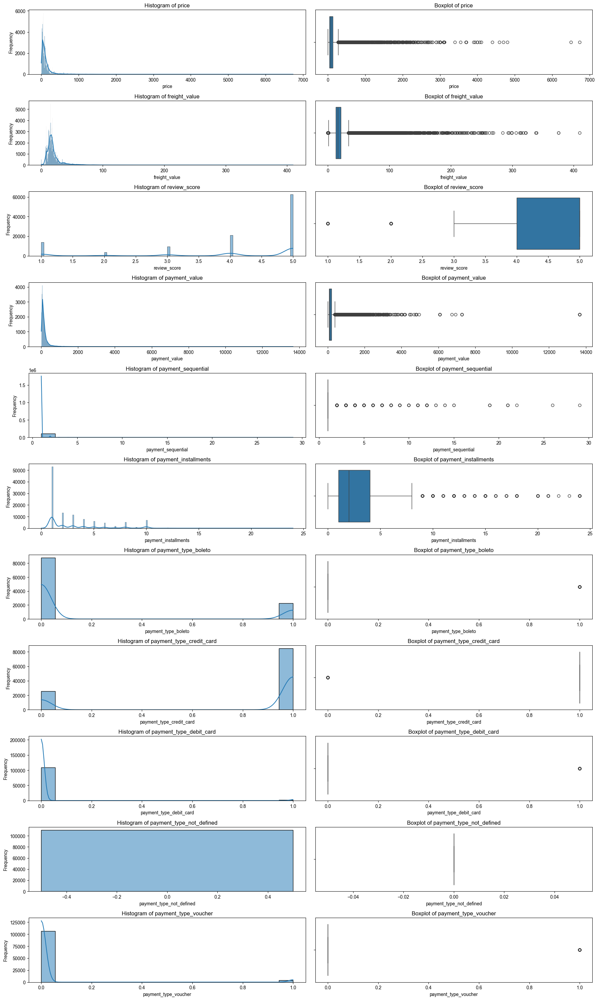

In [52]:
numerical = ['price', 'freight_value', 'review_score', 'payment_value', 'payment_sequential', 'payment_installments', 'payment_type_boleto', 'payment_type_credit_card', 'payment_type_debit_card', 'payment_type_not_defined', 'payment_type_voucher']

plt.figure(figsize=(18, 30))

for index, col in enumerate(numerical):
    # Histogram
    plt.subplot(len(numerical), 2, index * 2 + 1)
    sns.histplot(df_merge[col], kde= True)
    plt.title(f'Histogram of {col}', size=12)
    plt.xlabel(col)
    plt.ylabel('Frequency')

    # Boxplot
    plt.subplot(len(numerical), 2, index * 2 + 2)
    sns.boxplot(x=df_merge[col])
    plt.title(f'Boxplot of {col}', size=12)
    plt.xlabel(col)

sns.set_style("darkgrid")
plt.tight_layout()
plt.show()

**Insights:**

- All numerical features in the dataset does not have a normal distribution, majority have a right skewed distribution whlie some have a left skewed distribution
- From the histogram we can see that almost every feature has an imbalance data in them. 

### **4.1.2 Top 10 States Distribution**

/var/folders/cr/hz35zl7n47s127kxhzszt_wc0000gn/T/ipykernel_92903/3835266948.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  plot = sns.barplot(x=top10_state.values, y=top10_state.index, palette="dark:#5A9")


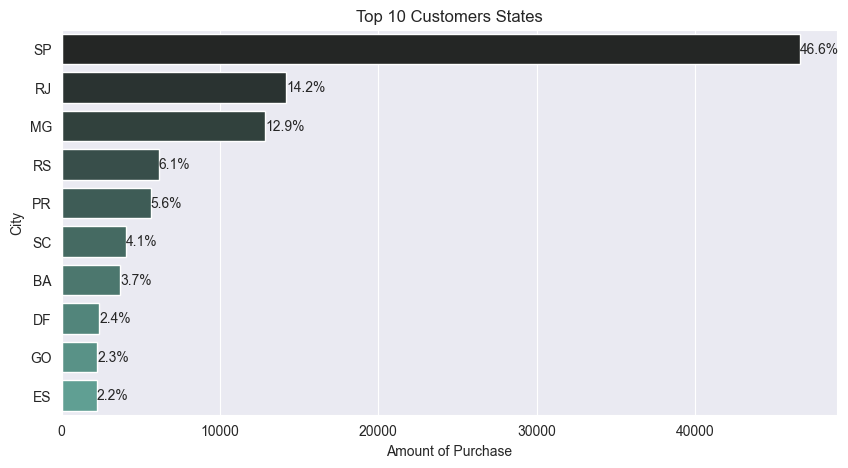

In [53]:
top10_state = df_merge['customer_state'].value_counts().head(10)

plt.figure(figsize=(10, 5))
plot = sns.barplot(x=top10_state.values, y=top10_state.index, palette="dark:#5A9")
for p in plot.patches:
    percentage = '{:.1f}%'.format(100 * p.get_width()/top10_state.sum())
    x = p.get_x() + p.get_width() + 0.02
    y = p.get_y() + p.get_height()/2
    plot.annotate(percentage, (x, y), ha='left', va='center')
plt.xlabel("Amount of Purchase")
plt.ylabel("City")
plt.title('Top 10 Customers States')
plt.show()

**Insights:**
- SP Dominates the Sales    
    - The state of São Paulo (SP) accounts for 46.6% of total purchases, significantly more than any other state.
    - This suggests a concentration of customers or higher purchasing power in this region due.

- The Next Top Contributors
    - Rio de Janeiro (RJ) - 14.2% and Minas Gerais (MG) - 12.9% are the next two highest contributors.
    - Together, SP, RJ, and MG contribute to over 73% of total purchases.

- Steep Drop After Top 3 States
    - After MG, there’s a notable decline, with the next state (RS) contributing only 6.1%.
    - The bottom five states (SC, BA, DF, GO, ES) contribute between 2.2% - 4.1%, suggesting a long tail of smaller contributions

- Possible Business Strategies
    - If focusing on growth, understanding why SP performs so well and replicating that in other states could be beneficial.
    - If aiming for market expansion, targeting mid-level states (like RS, PR, and SC) may provide opportunities.

### **4.1.3 Top 10 Cities Distribution**

/var/folders/cr/hz35zl7n47s127kxhzszt_wc0000gn/T/ipykernel_92903/3700161684.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  plot = sns.barplot(x=top10_cities.values, y=top10_cities.index, palette= "dark:#5A9")


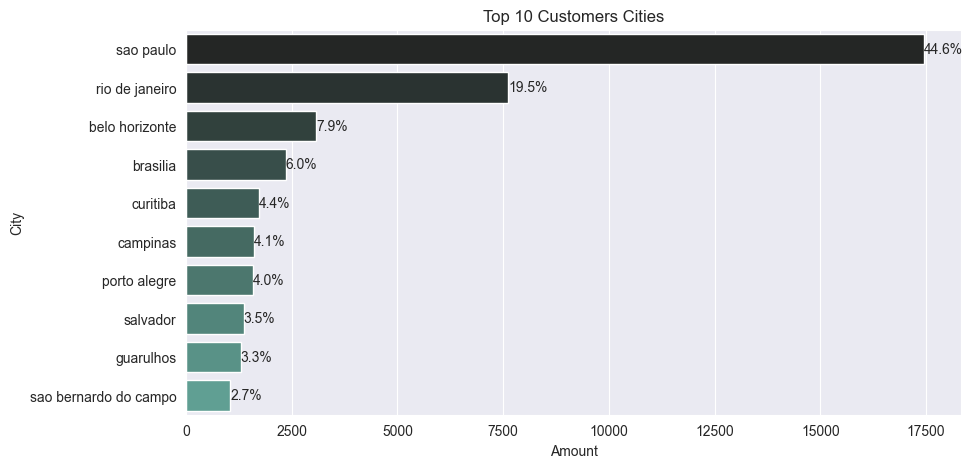

In [54]:
top10_cities = df_merge['customer_city'].value_counts().head(10)

plt.figure(figsize=(10, 5))
plot = sns.barplot(x=top10_cities.values, y=top10_cities.index, palette= "dark:#5A9")
for p in plot.patches:
    percentage = '{:.1f}%'.format(100 * p.get_width()/top10_cities.sum())
    x = p.get_x() + p.get_width() + 0.02
    y = p.get_y() + p.get_height()/2
    plot.annotate(percentage, (x, y), ha='left', va='center')
plt.xlabel("Amount")
plt.ylabel("City")
plt.title('Top 10 Customers Cities')
plt.show()

**Insights:**

- São Paulo Dominates the Market
    - São Paulo city alone contributes 44.6% of the total purchases, making it the clear leader.
    - This suggests a high customer base, purchasing power, or strong market presence in this city.

- Rio de Janeiro is a Distant Second
    - With 19.5%, Rio de Janeiro contributes significantly but is less than half of São Paulo’s contribution.
    - This reinforces the trend seen in the Top 10 States graph, where SP also led by a wide margin.

- The Top 3 Cities Cover More Than 70% of Total Purchases
    - São Paulo (44.6%) + Rio de Janeiro (19.5%) + Belo Horizonte (7.9%) = 72%
    - This concentration indicates that most revenue comes from a few key urban centers.

- Moderate Contributions from Other Cities
    - Cities like Brasília (6.0%), Curitiba (4.4%), and Campinas (4.1%) contribute a moderate amount but are far behind the top 3.
    - These may present growth opportunities if market expansion strategies are applied.

### **4.1.4 Review Score Distribution**

/var/folders/cr/hz35zl7n47s127kxhzszt_wc0000gn/T/ipykernel_92903/540247563.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  plot = sns.countplot(x='review_score', data=df_merge, palette="dark:#5A9_r")


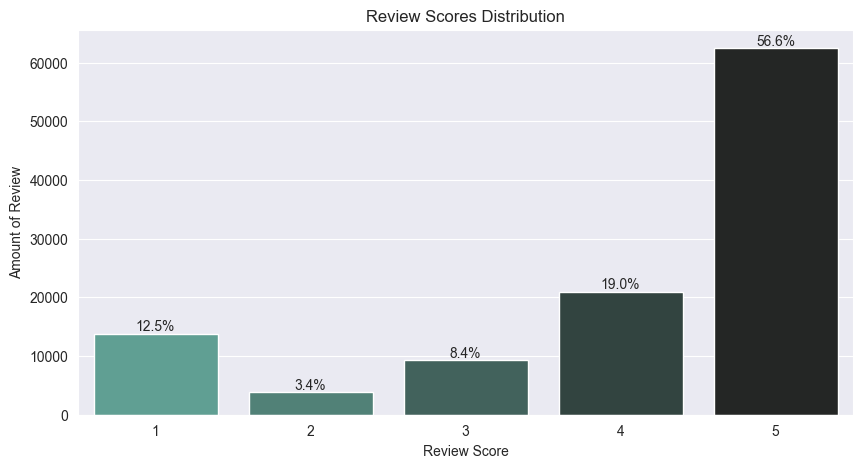

In [55]:
plt.figure(figsize=(10, 5))
plot = sns.countplot(x='review_score', data=df_merge, palette="dark:#5A9_r")
total_data = len(df_merge)
for p in plot.patches:
    percentage = '{:.1f}%'.format(100 * p.get_height()/total_data)
    x = p.get_x() + p.get_width()/2
    y = p.get_height() + 0.02
    plot.annotate(percentage, (x, y), ha='center', va='bottom')
plt.xlabel("Review Score")
plt.ylabel("Amount of Review")
plt.title('Review Scores Distribution')
plt.show()

**Insights**

- Satisfied Customers
    - 56.6% of customer are highly satisfied with their product leaving a 5 in review score
    - Review score of 5 and 4 are dominating the scores indicating that 75.6% customer are satisfied.
    - This suggest the quality of the products, the customer service, and the experience of purchasing at Olist are highly satisfying which should be maintained and can be a leverage for brand trust & growth

- Unsatisfied Customers
    - 12.5% of customer are not satisfied with only leaving 1 review score.
    - This needs further investigating whether it is the seller fault or the customer and give a penalty as to 1 review score can have a detrimental effect to the shop or the customer satisfaction.

### **4.1.4 Top 10 Products Distribution**

/var/folders/cr/hz35zl7n47s127kxhzszt_wc0000gn/T/ipykernel_92903/2903740816.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  plot = sns.barplot(x=top10_products.values, y=top10_products.index, palette="dark:#5A9")


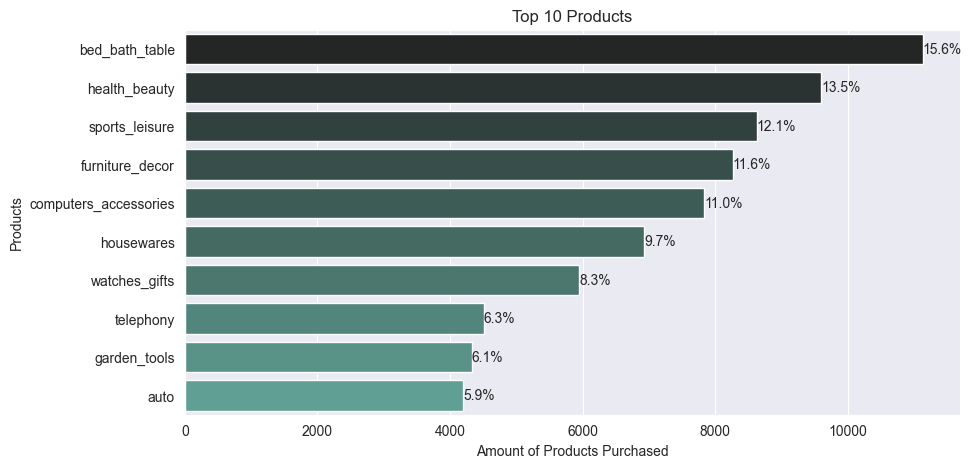

In [56]:
top10_products = df_merge['product_category_name_english'].value_counts().head(10)

plt.figure(figsize=(10, 5))
plot = sns.barplot(x=top10_products.values, y=top10_products.index, palette="dark:#5A9")
for p in plot.patches:
    percentage = '{:.1f}%'.format(100 * p.get_width()/top10_products.sum())
    x = p.get_x() + p.get_width() + 0.02
    y = p.get_y() + p.get_height()/2
    plot.annotate(percentage, (x, y), ha='left', va='center')
plt.xlabel("Amount of Products Purchased")
plt.ylabel("Products")
plt.title('Top 10 Products')
plt.show()

**Insights:**
- The most popular product in Olist is bed bath table with 15.6% of the total top 10 products purchased
- The relatively low percentage and by the graph visualization suggest that all top 10 products are fairly distributed which means that customers has a wide range of interest in the products

### **4.1.4 Payment Installment Distribution**

/var/folders/cr/hz35zl7n47s127kxhzszt_wc0000gn/T/ipykernel_92903/2335196529.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  plot = sns.countplot(x = df_merge['payment_installments'], palette= "dark:#5A9")


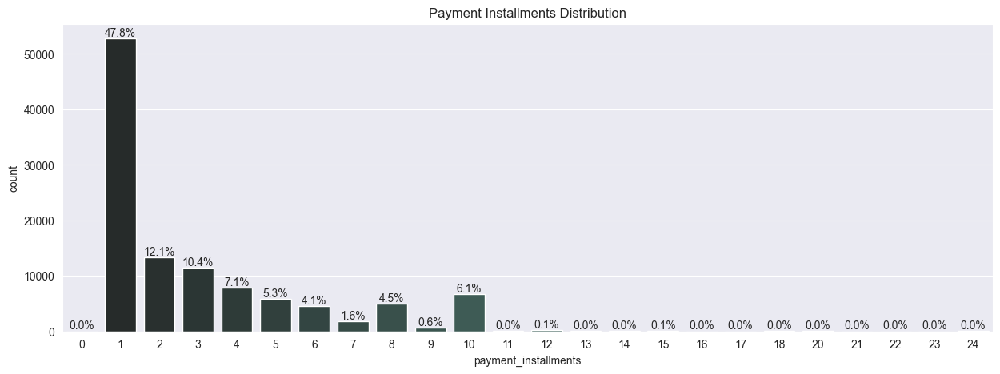

In [57]:
# Payment Installment
plt.figure(figsize=[15, 5])
plot = sns.countplot(x = df_merge['payment_installments'], palette= "dark:#5A9")
total_data = len(df_merge)
for p in plot.patches:
    percentage = '{:.1f}%'.format(100 * p.get_height()/total_data)
    x = p.get_x() + p.get_width()/2
    y = p.get_height() + 0.02
    plot.annotate(percentage, (x, y), ha='center', va='bottom')
plt.title('Payment Installments Distribution')
plt.show()

**Insights:**

- High Percentage (47.8%) of One-Time Payments:
    - This suggests customer prefer upfront payments and are financially capable.
    - Marketing could focus on discounts for one-time payments to encourage bulk purchases

- High Usage of Installments (2x - 10x):
    - A higher number of installment users indicates that customers rely on credit for affordability.
    - Offering interest-free installment plans could increase conversion rates for high-ticket items.

## **4.2 Bivariate and Multivariate Analysis**

### **4.2.1 Correlation Matrix**

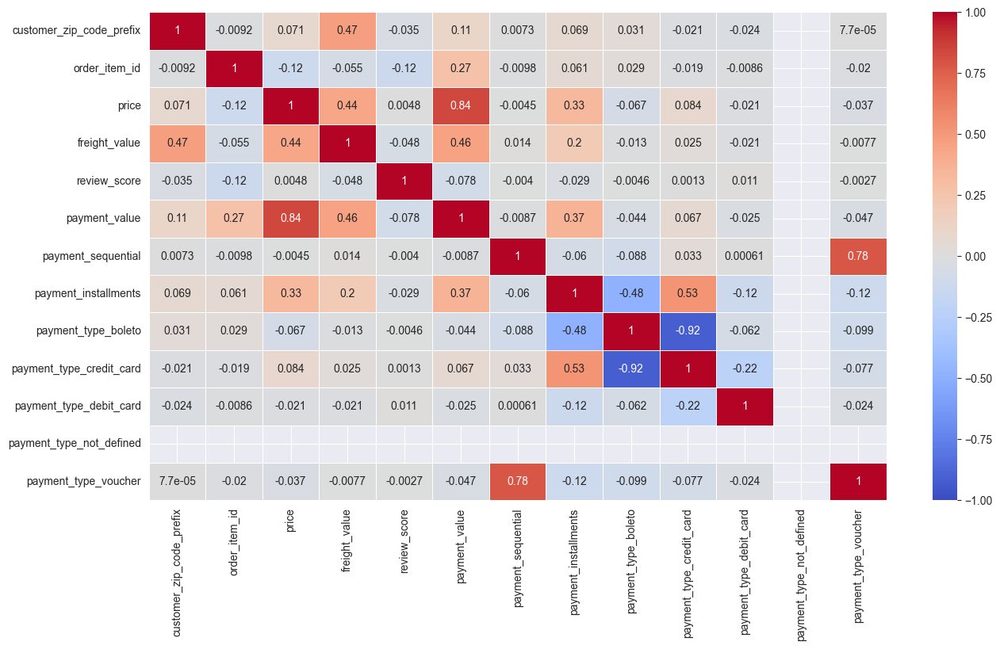

In [58]:
plt.figure(figsize=(15,8))
sns.heatmap(df_merge.select_dtypes(include= np.number).corr('spearman'), vmin=-1, vmax=1, annot=True, cmap="coolwarm", linewidths=0.5)
plt.show()

**Insights:**
 
- Weak Correlation (0.0 - 0.2):
    - Majority of the features has low correlation between eachother

- Notable Correlation:
    - payment type voucher and payment sequential, 0.78 correlation
    - payment installment and price, 0.33 correlation
    - payment installment and payment type credit card, 0.53 correlation
    - payment installment and payment type boleto, -0.48 correlation
    - customer zip code prefix and freight value, 0.47 correlation

### **4.2.2 Revenue and Order Trends**

We will see how the monthly order volume and revenue trend of Olist data from 2017-2018.

In [59]:
df_merge["order_date"] = df_merge["order_purchase_timestamp"].dt.date
df_merge["order_year"] = df_merge["order_purchase_timestamp"].dt.year
df_merge["order_month"] = df_merge["order_purchase_timestamp"].dt.month

In [60]:
daily_trend = df_merge.groupby("order_date").agg(
    total_orders=("order_id", "count"),
    total_revenue=("payment_value", "sum")
).reset_index()

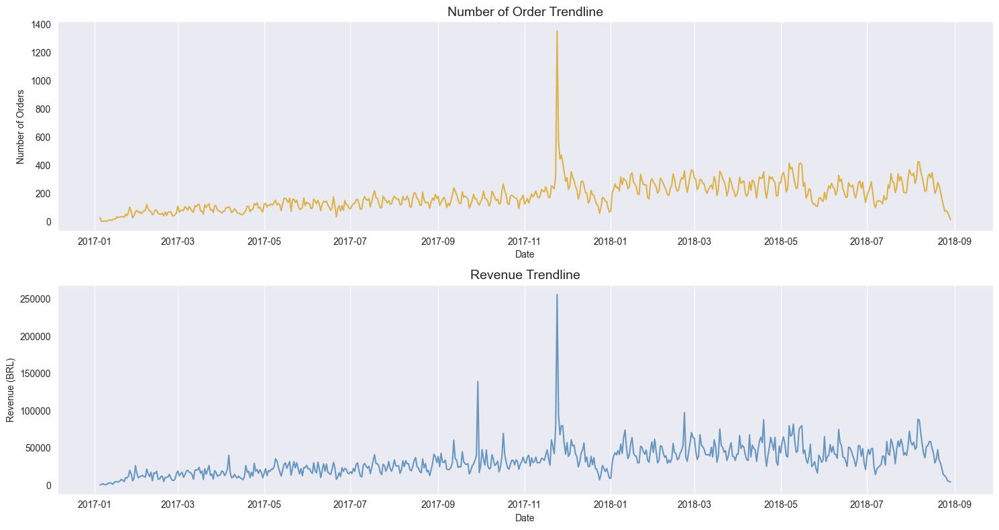

In [61]:
fig, axes = plt.subplots(nrows=2, ncols=1, figsize=(15, 8))

axes[0].plot(daily_trend["order_date"], daily_trend["total_orders"], color="goldenrod", alpha=0.8)
axes[0].set_title("Number of Order Trendline", fontsize=14)
axes[0].set_ylabel("Number of Orders")
axes[0].set_xlabel("Date")
axes[0].grid(axis='y')


axes[1].plot(daily_trend["order_date"], daily_trend["total_revenue"], color="steelblue", alpha=0.8)
axes[1].set_title("Revenue Trendline", fontsize=14)
axes[1].set_ylabel("Revenue (BRL)")
axes[1].set_xlabel("Date")
axes[1].grid(axis='y')


# plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

**Insights:**

- The trend for amount of order and revenue are directly proportional
- As there is a date where the order and revenue shows a very sudden increase, it appears that there is a period in November 24th, 2017 is black friday date. 
As in Brazil, ecommerce on Black Friday digital sales has increase significantly, as reported by statista.

https://www.statista.com/topics/6451/black-friday-e-commerce-in-brazil/

### **4.2.3 States Analysis**


#### **4.2.3.1 Quarterly Revenue on Top 5 States**

In [62]:
df_merge['order_quarter'] = df_merge['order_purchase_timestamp'].dt.to_period('Q')

In [63]:
state_revenue_quarterly = df_merge.groupby(['customer_state', 'order_quarter']).agg(
    revenue=('payment_value', 'sum')
).reset_index()

In [64]:
total_revenue_by_state = state_revenue_quarterly.groupby("customer_state")["revenue"].sum().reset_index()
top5_states = total_revenue_by_state.sort_values(by="revenue", ascending=False).head(5)["customer_state"]
bottom5_states = total_revenue_by_state.sort_values(by="revenue", ascending=True).head(5)["customer_state"]

In [65]:
stacked_data_top = state_revenue_quarterly[state_revenue_quarterly["customer_state"].isin(top5_states)]
stacked_data_bottom = state_revenue_quarterly[state_revenue_quarterly["customer_state"].isin(bottom5_states)]

In [66]:
stacked_data_qtop = stacked_data_top.pivot(index="order_quarter", columns="customer_state", values="revenue")
stacked_data_btop = stacked_data_bottom.pivot(index="order_quarter", columns="customer_state", values="revenue")

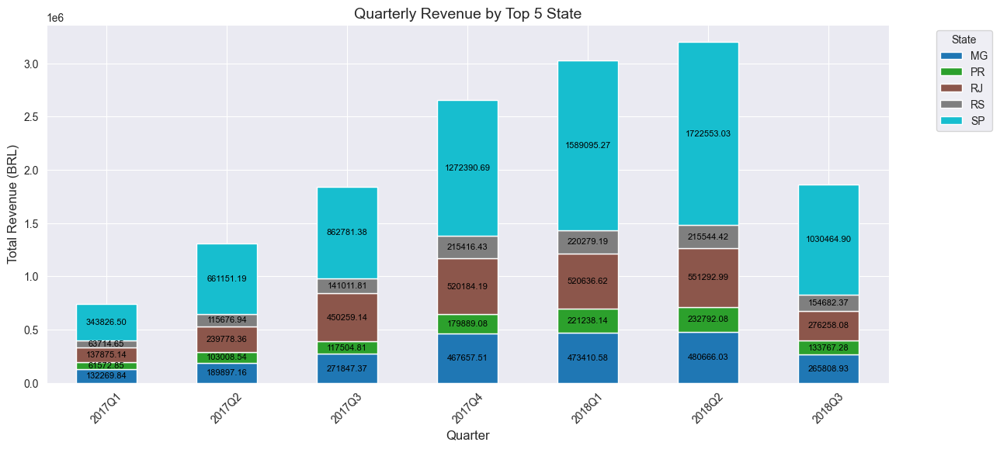

In [67]:
ax = stacked_data_qtop.plot(kind="bar", stacked=True, figsize=(14, 6), colormap="tab10")

# Formatting
plt.xlabel("Quarter", fontsize=12)
plt.ylabel("Total Revenue (BRL)", fontsize=12)
plt.title("Quarterly Revenue by Top 5 State", fontsize=14)
plt.xticks(rotation=45)
plt.legend(title="State", bbox_to_anchor=(1.05, 1), loc="upper left")  # Move legend outside

# Add data labels
for p in ax.patches:
    width, height = p.get_width(), p.get_height()
    x, y = p.get_xy()
    if height > 0:  # Only add labels for bars with height > 0
        ax.annotate(f'{height:.2f}', (x + width / 2, y + height / 2), ha='center', va='center', fontsize=8, color='black')

plt.show()

**Insights:**

- Quarterly Revenue Trend
    - There is an increase in revenue trend from Q1 2017 to Q2 2018 and a decrease in Q3 2018
    - Further investigation are needed to address the decrease as to what changed, is it from the system or the customer behavior and preferences

- Top Revenue
    - The biggest revenue Olist gained are in Q2 2018 with over 3 million BRL
    - The state that generate majority of the revenue is Sau Paulo (SP)

- Lowest Revenue
    - The lowest revenue Olist gained are in Q1 2017 with under 1 million BRL
    - The states that generate the leat revenue are Paraná (PR) and Rio Grande do Sul (RS)

- Marketing Strategies for Top 5 States
    - Identify successful marketing strategies from Q2 2018 and replicate them.
    - Reinforce partnerships with top-performing sellers and brands.
    - Increase localized ad campaigns targeting São Paulo’s customer base.
    - Identify underperforming states and create targeted growth campaigns.


#### **4.2.3.2 Quarterly Revenue on Bottom 5 States**

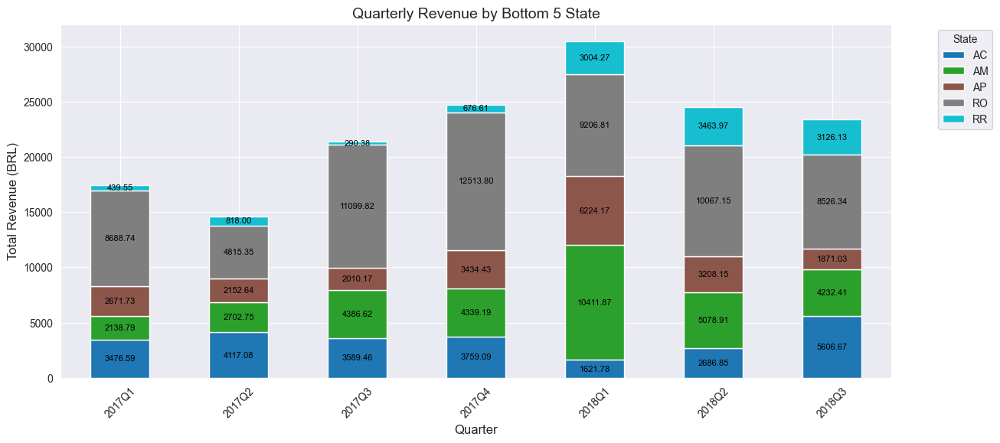

In [68]:
ax = stacked_data_btop.plot(kind="bar", stacked=True, figsize=(14, 6), colormap="tab10")

# Formatting
plt.xlabel("Quarter", fontsize=12)
plt.ylabel("Total Revenue (BRL)", fontsize=12)
plt.title("Quarterly Revenue by Bottom 5 State", fontsize=14)
plt.xticks(rotation=45)
plt.legend(title="State", bbox_to_anchor=(1.05, 1), loc="upper left")  # Move legend outside

# Add data labels
for p in ax.patches:
    width, height = p.get_width(), p.get_height()
    x, y = p.get_xy()
    if height > 0:  # Only add labels for bars with height > 0
        ax.annotate(f'{height:.2f}', (x + width / 2, y + height / 2), ha='center', va='center', fontsize=8, color='black')

plt.show()

**Insights:**

- Low-Contributing States
    - Rondônia (RO) consistently has the highest revenue among them, while Roraima (RR) has the lowest.

- Fluctuating Growth
    - Revenue shows a general increase from Q1 2017 to Q1 2018, indicating positive growth.
    - Q2 2018 and Q3 show a decline, especially in Rondônia (RO) and  Amazonas (AM), signaling potential market weakness.

- Marketing Strategies for Growth in Bottom 5 States
    - Investigate 2018Q1 Peak in AM
        - Identify factors that drove revenue growth and replicate successful campaigns.

    - Strengthen Localized Marketing
        - Launch state-specific promotions and discounts in AM and RO to recover Q2-Q3 losses.
        - Invest in influencer partnerships to boost brand awareness in these regions.

    - Optimize Logistics & Accessibility
        - Evaluate shipping & delivery efficiency in these states to improve customer experience.
        - Consider faster shipping options or local warehouses to increase accessibility.

#### **4.2.3.3 Top 10 States with The Highest Revenue**

/var/folders/cr/hz35zl7n47s127kxhzszt_wc0000gn/T/ipykernel_92903/4130569083.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.barplot(x='customer_state', y='payment_value', data=top10_state_revenue, palette='crest_r')


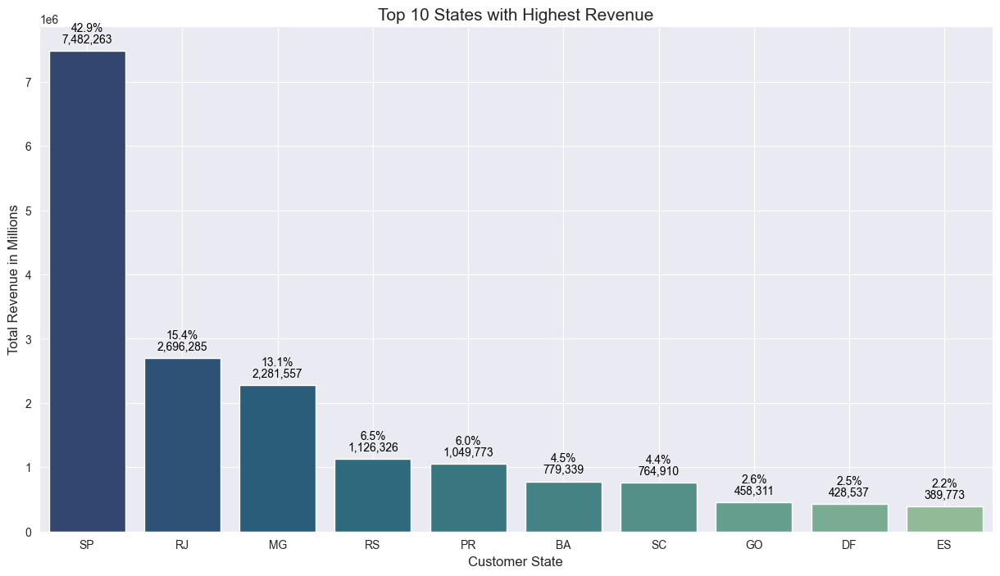

In [69]:
top10_state_revenue = df_merge.groupby("customer_state")["payment_value"].sum().nlargest(10).reset_index()

plt.figure(figsize=[15, 8])
ax = sns.barplot(x='customer_state', y='payment_value', data=top10_state_revenue, palette='crest_r')
for p in ax.patches:
    ax.annotate(f'{p.get_height():,.0f}', (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', fontsize=10, color='black', xytext=(0, 10),
                textcoords='offset points')
                
    percentage = '{:.1f}%'.format(100 * p.get_height()/top10_state_revenue["payment_value"].sum())
    ax.annotate(percentage, (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', fontsize=10, color='black', xytext=(0, 20),
                textcoords='offset points')

plt.title('Top 10 States with Highest Revenue', fontsize=15)
plt.xlabel('Customer State', fontsize=12)
plt.ylabel('Total Revenue in Millions', fontsize=12)
plt.grid(axis='x')
sns.despine()
plt.show()

**Insight:**

- The trend on Revenue in the Top 10 States are directly proportional with the amount of sales in the Top 10 States

- SP Generates the Highest Revenue    
    - The state of São Paulo (SP) accounts for 42.9%% of total revenue in the Top 10 States, significantly more than any other state.
    - Focused marketing in São Paulo (SP) could increase and/or maintain the revenue gain.

- The Next Top Contributors
    - Rio de Janeiro (RJ) - 15.4% and Minas Gerais (MG) - 13.1% are the next two highest contributors.
    - Together, SP, RJ, and MG contribute to over 71.4% of total purchases.

- Steep Drop After Top 3 States
    - After MG, there’s a notable decline, with the next state Rio Grande do Sul (RS) contributing only 6.5%.
    - The bottom five states (SC, BA, DF, GO, ES) contribute between 2.2% - 4.5%, suggesting a long tail of smaller contributions

- Possible Business Strategies
    - If focusing on growth, understanding why SP performs so well and replicating that in other states could be beneficial.
    - If aiming for market expansion, targeting mid-level states (like RS, PR, and SC) may provide opportunities.

#### **4.2.3.4 Bottom 10 States with The Lowest Revenue**

/var/folders/cr/hz35zl7n47s127kxhzszt_wc0000gn/T/ipykernel_92903/276536114.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.barplot(x='customer_state', y='payment_value', data=bot10_state_revenue, palette='crest_r')


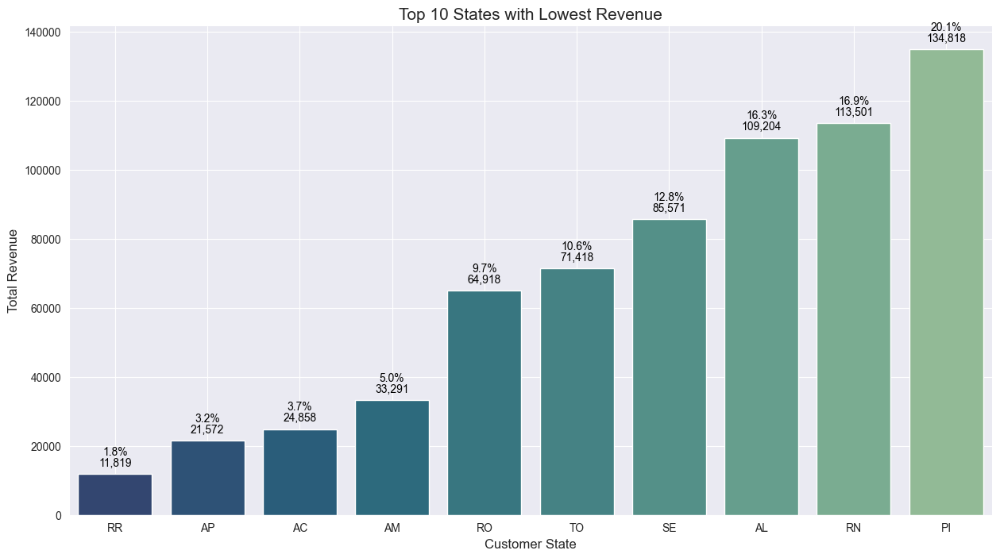

In [70]:
bot10_state_revenue = df_merge.groupby("customer_state")["payment_value"].sum().nsmallest(10).reset_index()

plt.figure(figsize=[15, 8])
ax = sns.barplot(x='customer_state', y='payment_value', data=bot10_state_revenue, palette='crest_r')
for p in ax.patches:
    ax.annotate(f'{p.get_height():,.0f}', (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', fontsize=10, color='black', xytext=(0, 10),
                textcoords='offset points')
    
    percentage = '{:.1f}%'.format(100 * p.get_height()/bot10_state_revenue["payment_value"].sum())
    ax.annotate(percentage, (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', fontsize=10, color='black', xytext=(0, 20),
                textcoords='offset points')

plt.title('Top 10 States with Lowest Revenue', fontsize=15)
plt.xlabel('Customer State', fontsize=12)
plt.ylabel('Total Revenue', fontsize=12)
plt.grid(axis='x')
sns.despine()
plt.show()

**Insights:**

- Lowest Revenue Contribution
    - From the Bottom 10 States, Piauí (PI) has the highest revenue contribution with BR 134,818 or 20.1% of the Bottom 5 States
    - The lowest revenue contribution is from Roraima (RR) with BR 11,819 or 1.8% of the Bottom 5 States

- Extremely Low Market Share
    - RR (1.8%), AP (3.2%), AC (3.7%), and AM (5.0%) have very low revenue contributions, suggesting weak market penetration.
    - Combined, they contribute only 13.7% of the revenue in the lowest-performing states, far behind the highest state in this group at 20.1%
    - These states likely have lower population density, purchasing power, or brand awareness.
    - The low engagement could indicate a need for better marketing and regional adaptation

- Possible Business Strategy
    - Increase brand awareness through region-specific ads and promotions.
    - Partner with local influencers and sellers to drive engagement.
    - Introduce faster and cost-effective shipping options to make products more accessible.
    - Consider regional fulfillment centers to reduce delivery time and costs.

#### **4.2.3.5 Top City in the Top 5 States with The Highest Revenue**

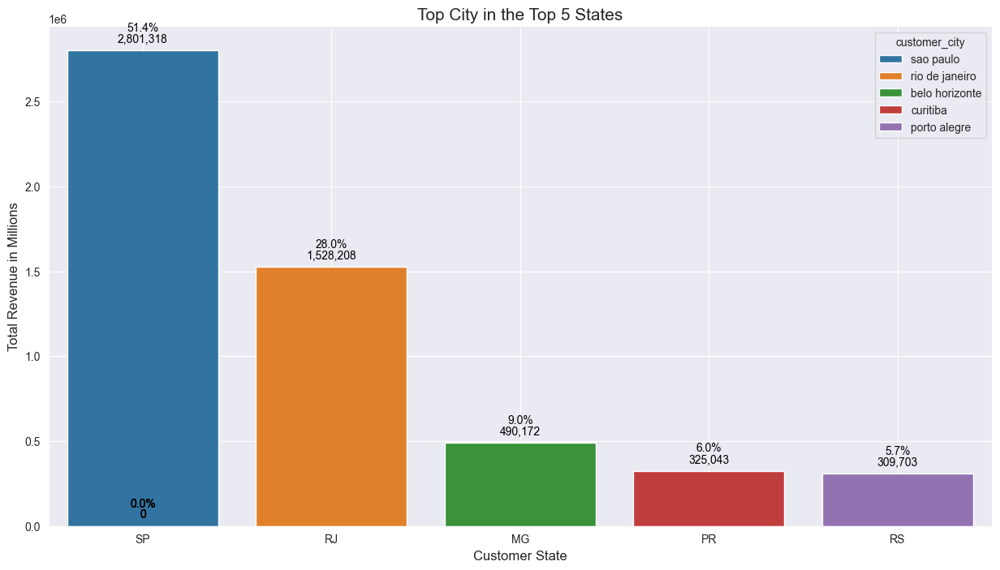

In [71]:
top_states = (df_merge.groupby("customer_state")["payment_value"]
              .sum()
              .nlargest(5)
              .index.tolist())

filtered_df = df_merge[df_merge["customer_state"].isin(top_states)]

topcities_top5states = filtered_df.groupby(["customer_city", "customer_state"])["payment_value"].sum().nlargest(5).reset_index()

plt.figure(figsize=[15, 8])
ax = sns.barplot(x='customer_state', y='payment_value', data=topcities_top5states, hue= "customer_city", palette='tab10')
for p in ax.patches:
    ax.annotate(f'{p.get_height():,.0f}', 
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', 
                va='center', 
                fontsize=10, 
                color='black', 
                xytext=(0, 10),
                textcoords='offset points')
    
    percentage = '{:.1f}%'.format(100 * p.get_height()/topcities_top5states["payment_value"].sum())
    ax.annotate(percentage, (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', fontsize=10, color='black', xytext=(0, 20),
                textcoords='offset points')

plt.title('Top City in the Top 5 States', fontsize=15)
plt.xlabel('Customer State', fontsize=12)
plt.ylabel('Total Revenue in Millions', fontsize=12)
plt.grid(axis='x')
sns.despine()
plt.show()

**Insights:**

- Heavy Revenue Concentration in São Paulo (SP)
    - São Paulo alone dominates with 51.4%, indicating a highly centralized revenue stream.
    - A potential over-reliance on a single market poses a risk if economic conditions change.

- Large Gap Between Top Cities
    - The 23.4% gap between SP and RJ suggests a significant disparity in purchasing power and market penetration.
    - Similarly, the 19% gap between RJ and MG shows that even in high-revenue states, revenue is unevenly distributed.

- Market Expansion Opportunity in Lower-Tier Cities
    - If SP is at saturation, focusing on mid-sized cities in RJ, MG, and other growing urban centers can increase market share.
    - Expanding beyond the state capitals can help distribute revenue more evenly.

- Diversify Beyond São Paulo (SP)
    - Target second-tier cities within RJ, MG, and other states through localized campaigns.
    - Offer exclusive deals in cities with lower revenue contribution to boost customer engagement.

- Enhance Brand Presence in Rio de Janeiro (RJ) & Minas Gerais (MG)
    - Since RJ lags 23.4% behind SP, increase ad spending in high-traffic areas and online campaigns tailored to RJ consumers.
    - Use data-driven insights to identify key purchasing behaviors in MG and adjust marketing strategies accordingly.

#### **4.2.3.5 Top 5 Products in the Top 5 States with The Highest Revenue**

/var/folders/cr/hz35zl7n47s127kxhzszt_wc0000gn/T/ipykernel_92903/1626190329.py:10: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  top5_products_states = grouped.groupby('customer_state').apply(lambda x: x.nlargest(5, 'payment_value')).reset_index(drop=True)


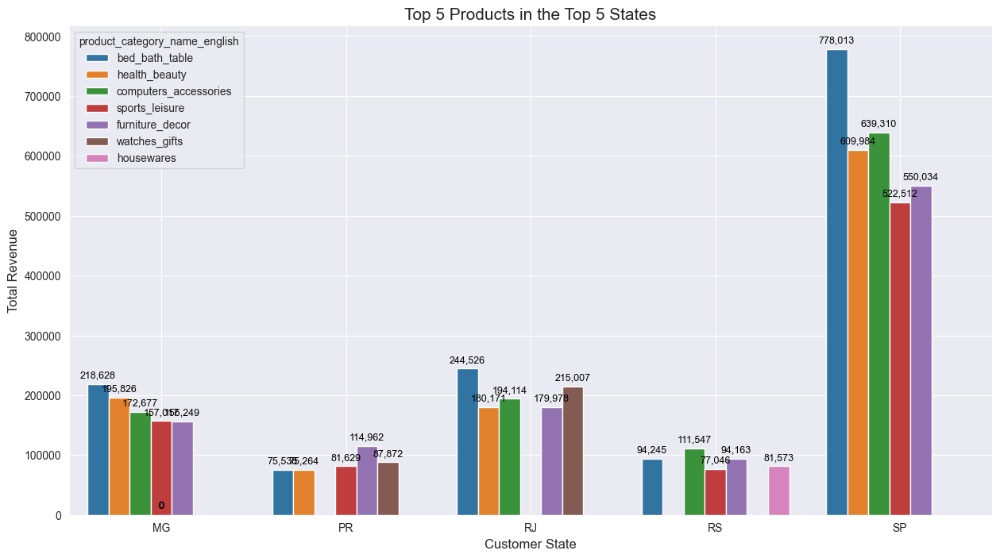

In [72]:
top5_states = (df_merge.groupby("customer_state")["payment_value"]
              .sum()
              .nlargest(5)
              .index.tolist())

filtered_df = df_merge[df_merge['customer_state'].isin(top5_states)]

grouped = filtered_df.groupby(['customer_state', 'product_category_name_english']).agg({'payment_value': 'sum'}).reset_index()

top5_products_states = grouped.groupby('customer_state').apply(lambda x: x.nlargest(5, 'payment_value')).reset_index(drop=True)

plt.figure(figsize=[15, 8])
ax = sns.barplot(x='customer_state', y='payment_value', data=top5_products_states, hue= "product_category_name_english", palette='tab10')
for p in ax.patches:
    ax.annotate(f'{p.get_height():,.0f}', 
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', 
                va='center', 
                fontsize=9, 
                color='black', 
                xytext=(0, 8),
                textcoords='offset points')

plt.title('Top 5 Products in the Top 5 States', fontsize=15)
plt.xlabel('Customer State', fontsize=12)
plt.ylabel('Total Revenue', fontsize=12)
plt.grid(axis='x')
sns.despine()
plt.show()

**Insights:**

- Consistency in Best-Selling Products Across State
    - The similarity in top 5 products across states suggests that customer preferences are relatively uniform.
    - This allows for scalable marketing strategies, but regional adjustments may still be needed.

- Bed Bath Table Dominates Revenue in Most States
    - In 3 out of 5 states, this category consistently generates the highest revenue, indicating strong demand.
    - São Paulo (SP) stands out with BRL 778,013, suggesting a premium customer base willing to invest in home essentials.

- Furniture Decor Performs Uniquely in Paraná (PR)
    - Unlike other states where furniture decor falls behind, in PR, it is the top revenue-generating category (BRL 114,962).
    - This suggests a regional preference for home aesthetics, which should be leveraged in marketing.

- Amplify Bed Bath Table Sales with Premium Marketing
    - Since Bed Bath Table is the dominant revenue generator, create bundled offers or seasonal discounts.
    - Highlight high-end versions of these products in São Paulo (SP), where customers may have higher spending power.

- Leverage Furniture Decor’s Strength in PR
    - Given its uniqueness in Paraná (PR), launch targeted campaigns showcasing exclusive furniture decor designs.
    - Use localized influencer marketing to increase demand and expand category dominance to other states.

- Customize Regional Product Promotions
    - Offer state-specific promotions in PR, RJ, and RS for their top-selling but unique products.
    - Optimize ad targeting based on regional buying patterns to increase conversion rates.

### **4.2.4 City Analysis**


#### **4.2.4.1 Top 10 City with The Highest Revenue**

/var/folders/cr/hz35zl7n47s127kxhzszt_wc0000gn/T/ipykernel_92903/1272970648.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.barplot(x='customer_city', y='payment_value', data=top10_city_revenue, palette='crest_r')


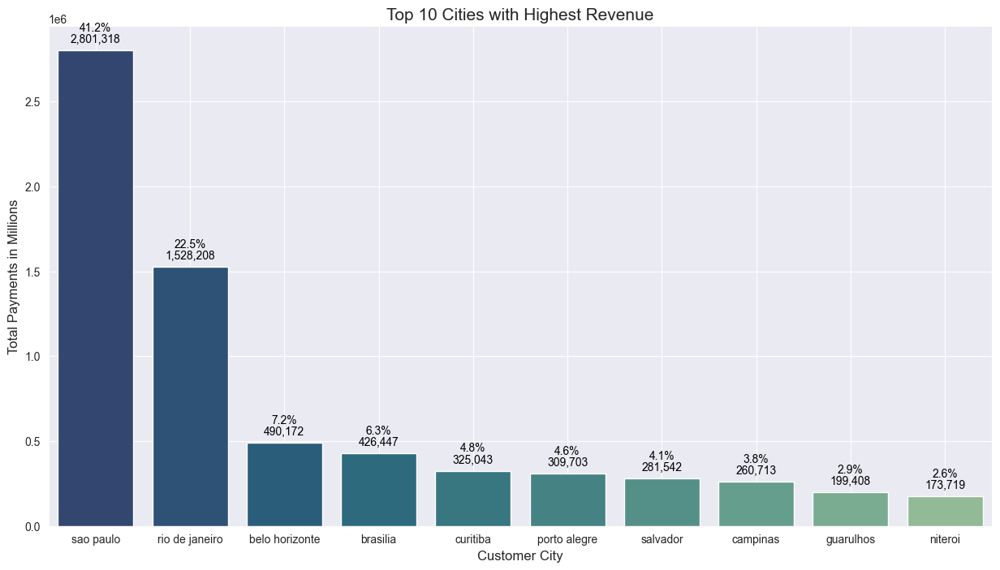

In [73]:
top10_city_revenue = df_merge.groupby("customer_city")["payment_value"].sum().nlargest(10).reset_index()

plt.figure(figsize=[15, 8])
ax = sns.barplot(x='customer_city', y='payment_value', data=top10_city_revenue, palette='crest_r')
for p in ax.patches:
    ax.annotate(f'{p.get_height():,.0f}', (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', fontsize=10, color='black', xytext=(0, 10),
                textcoords='offset points')

    percentage = '{:.1f}%'.format(100 * p.get_height()/top10_city_revenue["payment_value"].sum())
    ax.annotate(percentage, (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', fontsize=10, color='black', xytext=(0, 20),
                textcoords='offset points')
    
plt.title('Top 10 Cities with Highest Revenue', fontsize=15)
plt.xlabel('Customer City', fontsize=12)
plt.ylabel('Total Payments in Millions', fontsize=12)
plt.grid(axis='x')
sns.despine()
plt.show()

**Insights:**

- Sao Paulo’s Revenue Dominance
    - With 41% of the total revenue from the top 10 cities, São Paulo is the undisputed revenue leader.
    - This suggests a high concentration of demand, making it a prime location for targeted marketing and logistics optimization.

- Significant Revenue Drop from 1st to 2nd Place
    - An 18.7% gap between São Paulo and the second city highlights a strong disparity in purchasing power or market size.
    - The potential growth in the second-largest city should be explored through promotions and localized campaigns.

- Extreme Revenue Gap from 1st to Last Place (Niterói)
    - A 38.6% difference between São Paulo and Niterói suggests that smaller cities may have untapped market potential.
    - Understanding the barriers to higher sales in lower-performing cities (e.g., logistics, pricing, awareness) is crucial for expansion.

- Potential for Expansion in Mid-Tier Cities
    - The middle-ranking cities could be leveraged to close the revenue gap through strategic discounts, better delivery options, and local promotions.
    - Instead of focusing solely on São Paulo, an incremental boost across several mid-tier cities could yield a significant revenue increase.

#### **4.2.4.2 Top 5 Products in the Top 5 City with The Highest Revenue**

/var/folders/cr/hz35zl7n47s127kxhzszt_wc0000gn/T/ipykernel_92903/2025191892.py:10: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  top5_products_city = grouped.groupby('customer_city').apply(lambda x: x.nlargest(5, 'payment_value')).reset_index(drop=True)


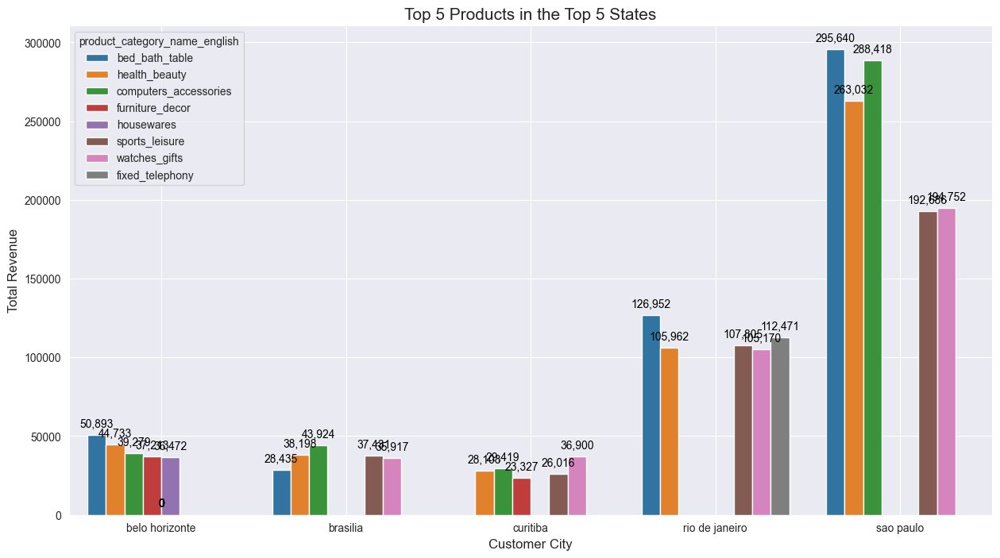

In [74]:
top5_city = (df_merge.groupby("customer_city")["payment_value"]
             .sum()
             .nlargest(5)
             .index.tolist())

filtered_df = df_merge[df_merge['customer_city'].isin(top5_city)]

grouped = filtered_df.groupby(['customer_city', 'product_category_name_english']).agg({'payment_value': 'sum'}).reset_index()

top5_products_city = grouped.groupby('customer_city').apply(lambda x: x.nlargest(5, 'payment_value')).reset_index(drop=True)

plt.figure(figsize=[15, 8])
ax = sns.barplot(x='customer_city', y='payment_value', data=top5_products_city, hue= "product_category_name_english", palette='tab10')
for p in ax.patches:
    ax.annotate(f'{p.get_height():,.0f}', 
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', 
                va='center', 
                fontsize=10, 
                color='black', 
                xytext=(0, 10),
                textcoords='offset points')

plt.title('Top 5 Products in the Top 5 States', fontsize=15)
plt.xlabel('Customer City', fontsize=12)
plt.ylabel('Total Revenue', fontsize=12)
plt.grid(axis='x')
sns.despine()
plt.show()

**Insights:**

- Regional Product Preferences Vary
    - While Bed Bath Table dominates in São Paulo, Rio de Janeiro, and Belo Horizonte, it underperforms in Brasília and Curitiba.
    - This indicates regional differences in consumer preferences, requiring city-specific product marketing strategies rather than a one-size-fits-all approach.

- Brasília and Curitiba Show Unique Buying Behavior
    - Brasília has Bed Bath Table as the lowest-performing product, while Curitiba doesn’t have it in the top 5 at all.
    - This suggests that customer demand is driven by lifestyle, demographics, or economic factors, which must be analyzed further.

- The Need for a City-Specific Product Strategy
    - Each of the top 5 cities has at least one unique product in its top 5, meaning that a generalized marketing approach may not be effective.
    - Olist should customize inventory, promotions, and advertising for each city based on its demand patterns.

### **4.2.5 Product Analysis**

#### **4.2.5.1 Top 10 Product with the Highest Revenue**

/var/folders/cr/hz35zl7n47s127kxhzszt_wc0000gn/T/ipykernel_92903/2964175584.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.barplot(x='product_category_name_english', y='payment_value', data=product_revenue, palette='crest_r')


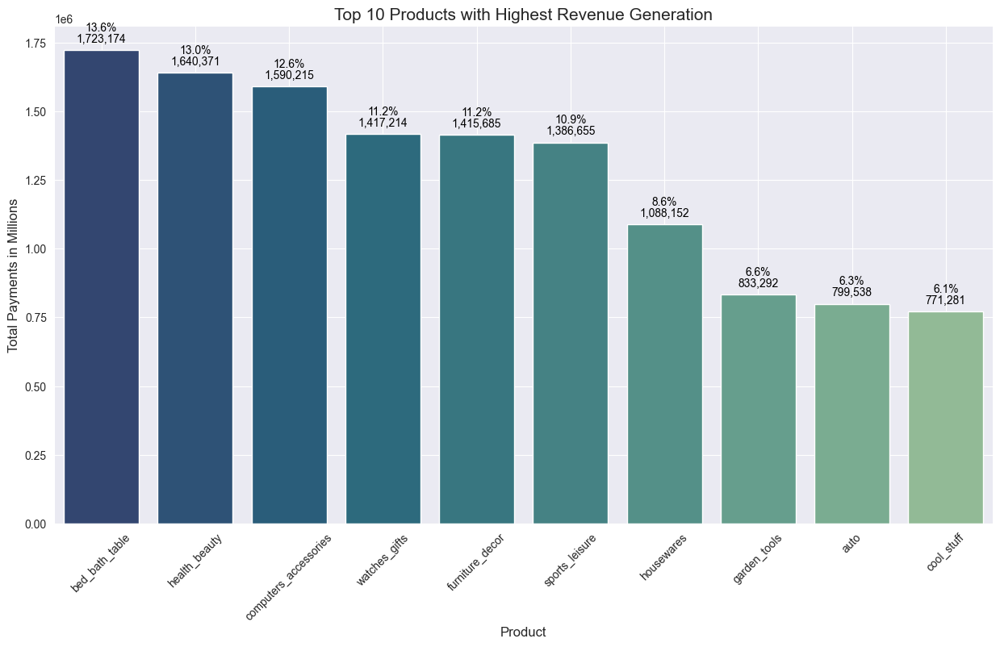

In [75]:
product_revenue = df_merge.groupby("product_category_name_english")["payment_value"].sum().nlargest(10).reset_index()

plt.figure(figsize=[15, 8])
ax = sns.barplot(x='product_category_name_english', y='payment_value', data=product_revenue, palette='crest_r')
for p in ax.patches:
    ax.annotate(f'{p.get_height():,.0f}', (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', fontsize=10, color='black', xytext=(0, 10),
                textcoords='offset points')

    percentage = '{:.1f}%'.format(100 * p.get_height()/product_revenue["payment_value"].sum())
    ax.annotate(percentage, (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', fontsize=10, color='black', xytext=(0, 20),
                textcoords='offset points')
    
plt.title('Top 10 Products with Highest Revenue Generation', fontsize=15)
plt.xlabel('Product', fontsize=12)
plt.xticks(rotation=45)
plt.ylabel('Total Payments in Millions', fontsize=12)
plt.grid(axis='x')
sns.despine()
plt.show()

**Insights:**

- Balanced Revenue Distribution Across Top 10 Products
    - The revenue distribution among the top 10 products is fairly even, with only a 7.5% gap between the highest and lowest.
    - This suggests no single product overwhelmingly dominates, making diversified marketing efforts more effective.

- Minimal Gap Between Top 2 Products (Bed Bath Table & Health Beauty)
    - A 0.6% revenue difference between Bed Bath Table and Health Beauty shows that both are highly competitive in demand.
    - This presents an opportunity for dynamic marketing strategies, seasonal promotions, or bundling these two categories together.

- Cool Stuff is the Lowest in Top 10, But Still Contributes Significantly
    - Despite being the lowest, Cool Stuff still holds 6.1% of the total revenue, meaning it has potential for growth with better positioning and advertising.

- A Wide Range of Popular Products Reduces Risk
    - Since no single product contributes over 15%, Olist has a balanced revenue stream that minimizes dependency on any one item.
    - This reduces the risk of revenue loss if demand drops for a particular product.

### **4.2.6 Retention Rate Analysis**

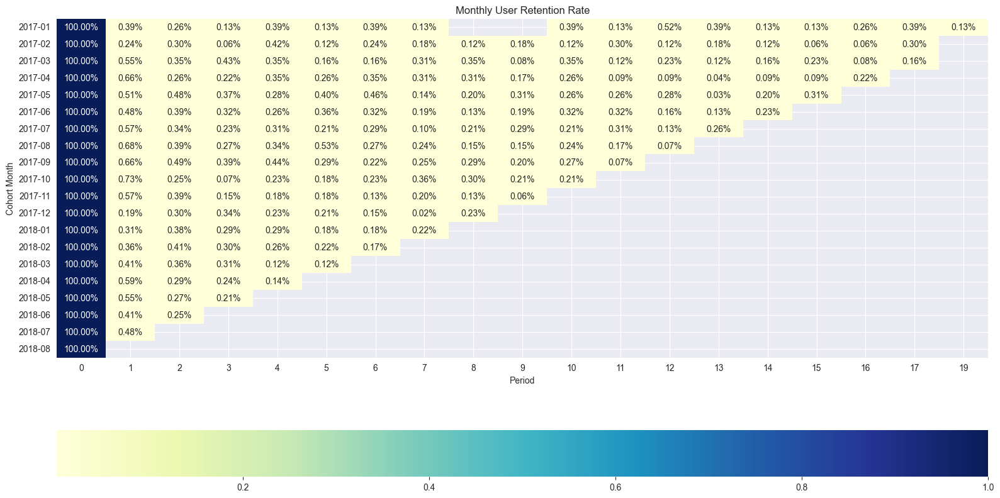

In [76]:
cohort_data = df_merge.copy()

cohort_data['order_purchase_timestamp'] = pd.to_datetime(cohort_data['order_purchase_timestamp'])
cohort_data['cohort_month'] = cohort_data.groupby('customer_unique_id')['order_purchase_timestamp'].transform('min').dt.to_period('M')
cohort_data['current_month'] = cohort_data['order_purchase_timestamp'].dt.to_period('M')

cohort_df = cohort_data.drop_duplicates(subset='order_id')[['customer_unique_id', 'current_month', 'cohort_month']]
cohort_df = cohort_df.groupby(['current_month', 'cohort_month']).size().reset_index(name='n_customers')
cohort_df['period'] = (cohort_df['current_month'] - cohort_df['cohort_month']).apply(lambda x: x.n)

pivot_cohort = cohort_df.pivot_table(index='cohort_month', columns='period', values='n_customers')
pivot_cohort = pivot_cohort.divide(pivot_cohort[0], axis=0)

plt.figure(figsize=(16, 8))
sns.heatmap(pivot_cohort, annot=True, fmt='.2%', cmap='YlGnBu', cbar_kws={'orientation': 'horizontal'})
plt.tight_layout()
plt.xlabel('Period')
plt.ylabel('Cohort Month')
plt.title('Monthly User Retention Rate')
plt.show()

**Insights:**

- User Retention Drops Quickly Over Time
    -In each cohort, the retention rate declines significantly after the first month.
    - Most users drop off within the first 2-3 months, indicating low long-term engagement.

- Slightly Better Retention for Some Cohorts
    - Some months (e.g., 2017-10, 2017-09) have slightly better retention rates in the early months compared to others.
    - This suggests possible seasonal effects, marketing efforts, or product improvements influencing retention.

- Retention Beyond 6 Months is Minimal
    - After 6 months, retention rates are generally below 0.5%, meaning very few users remain active.
    - This indicates difficulty in sustaining long-term user engagement.

- Retention Spikes in Certain Later Periods
    - Some cohorts show unexpected retention spikes in later months (e.g., 2017-01, 2017-02, 2017-06, etc.).
    - This might indicate successful re-engagement campaigns, seasonal trends, or product changes.

- Newer Cohorts Don't Show Significant Improvements
    - There is no clear trend of newer cohorts performing significantly better than older ones.
    - This suggests that user retention challenges persist despite any changes in strategy.

**Strategies to Improve User Retention**
- Onboarding Optimization
    - Since most users drop off early, focus on improving the first-time user experience.
    - Use guided tutorials, personalized recommendations, and incentives to keep users engaged beyond the first month.

- Early Engagement & Rewards
    - Offer early engagement rewards (e.g., discounts, free trials, exclusive content) to retain users past the first 2-3 months.
    - Implement loyalty programs to encourage repeat interactions.

- Re-Engagement Campaigns
    - Identify users who are at risk of churning and send targeted emails, notifications, or special offers.
    - Experiment with reactivation campaigns for users who return after several months of inactivity.

- Content & Feature Enhancements
    - Analyze which features or products drive long-term retention and highlight them more.
    - If retention spikes in certain periods, investigate what worked and replicate those strategies.

# **5. RFM Analysis**

RFM (Recency, Frequency, Monetary) analysis is a customer segmentation technique that helps categorize customers based on their purchase behavior. RFM used to identify a business's best clients based on the nature of their spending habits.


RFM analysis evaluates clients and customers by scoring them in three categories: 

1.	Recency (R) → How recently did the customer make a purchase?

2.	Frequency (F) → How often does the customer make purchases?

3.	Monetary (M) → How much money has the customer spent?

RFM analysis numerically ranks a customer in each of these three categories. Customers were scored on a scale for each metric, with higher scores indicating greater recency, frequency, and monetary contribution.

RFM analysis helps firms reasonably predict which customers are likely to purchase their products again, how much revenue comes from new (vs. repeat) clients, and how to turn occasional buyers into habitual ones.

[Reff][3] 

[3]:https://www.researchgate.net/publication/362114295_An_E-commerce_Customer_Segmentation_Method_based_on_RFM_Weighted_K-means/link/6597f7ea2468df72d3fd0a36/download?_tp=eyJjb250ZXh0Ijp7ImZpcnN0UGFnZSI6InB1YmxpY2F0aW9uIiwicGFnZSI6InB1YmxpY2F0aW9uIn19


## **5.1 Recency (R)**

it measure how recent was the last purchase. Customer who purchased recently are more likely to buy again. So, we can calculate recency as the number of days since the last purchase. 


In [77]:
df_merge2=df_merge.copy()

In [78]:
reference_date = df_merge2['order_purchase_timestamp'].max()
recency = df_merge2.groupby('customer_unique_id')['order_purchase_timestamp'].max().reset_index()

In [79]:
reference_date

Timestamp('2018-08-29 15:00:37')

In [80]:
recency['Recency'] = (reference_date - recency['order_purchase_timestamp']).dt.days

In [81]:
recency.drop(columns=['order_purchase_timestamp'], inplace=True)

In [82]:
recency

,customer_unique_id,Recency
0,0000366f3b9a7992bf8c76cfdf3221e2,111
1,0000b849f77a49e4a4ce2b2a4ca5be3f,114
2,0000f46a3911fa3c0805444483337064,536
3,0000f6ccb0745a6a4b88665a16c9f078,320
4,0004aac84e0df4da2b147fca70cf8255,287
...,...,...
93098,fffcf5a5ff07b0908bd4e2dbc735a684,446
93099,fffea47cd6d3cc0a88bd621562a9d061,261
93100,ffff371b4d645b6ecea244b27531430a,567
93101,ffff5962728ec6157033ef9805bacc48,118


##  **5.2 Frequency (F)**

it measures how many often does the customer buy. higher frequency means a loyal customer. 

In [83]:
frequency = df_merge2.groupby('customer_unique_id')['order_id'].nunique().reset_index()
frequency.columns = ['customer_unique_id', 'Frequency']


In [84]:
frequency.head()

,customer_unique_id,Frequency
0,0000366f3b9a7992bf8c76cfdf3221e2,1
1,0000b849f77a49e4a4ce2b2a4ca5be3f,1
2,0000f46a3911fa3c0805444483337064,1
3,0000f6ccb0745a6a4b88665a16c9f078,1
4,0004aac84e0df4da2b147fca70cf8255,1


## **5.3 Monetary (M)**

it measure how much money has the customer spent. A high monetary value means the customer is a big spender. 

In [85]:
monetary = df_merge2.groupby('customer_unique_id')['price'].sum().reset_index()
monetary.columns = ['customer_unique_id', 'Monetary']

In [86]:
monetary.head()

,customer_unique_id,Monetary
0,0000366f3b9a7992bf8c76cfdf3221e2,129.90
1,0000b849f77a49e4a4ce2b2a4ca5be3f,18.90
2,0000f46a3911fa3c0805444483337064,69.00
3,0000f6ccb0745a6a4b88665a16c9f078,25.99
4,0004aac84e0df4da2b147fca70cf8255,180.00


## **5.4 Data Preprocessing for RFM analysis**
Let's combine all three columns Recency, Frequency and Monetary to facilitate further step

In [87]:
# Merge Recency, Frequency, and Monetary data
rfm = recency.merge(frequency, on='customer_unique_id').merge(monetary, on='customer_unique_id')

In [88]:
rfm

,customer_unique_id,Recency,Frequency,Monetary
0,0000366f3b9a7992bf8c76cfdf3221e2,111,1,129.90
1,0000b849f77a49e4a4ce2b2a4ca5be3f,114,1,18.90
2,0000f46a3911fa3c0805444483337064,536,1,69.00
3,0000f6ccb0745a6a4b88665a16c9f078,320,1,25.99
4,0004aac84e0df4da2b147fca70cf8255,287,1,180.00
...,...,...,...,...
93098,fffcf5a5ff07b0908bd4e2dbc735a684,446,1,1570.00
93099,fffea47cd6d3cc0a88bd621562a9d061,261,1,64.89
93100,ffff371b4d645b6ecea244b27531430a,567,1,89.90
93101,ffff5962728ec6157033ef9805bacc48,118,1,115.00


Since RFM values have different scales (e.g., Recency could be 1-1000 days, while Frequency might be 1-50 orders), we will need to assign scores in RFM analysis using rule-based approach.

If we use raw RFM values, we can’t compare customers easily. So we asssigning scores makes it easier to categorize customers based on their behavior.

For scoring, the criteria are as follows:

•	Recency: Customers who made a purchase yesterday will receive a higher score compared to those who purchased a year ago.

•	Frequency: The more often a customer makes a purchase, the higher the score they receive.

•	Monetary: The higher the total amount a customer spends, the higher their scor

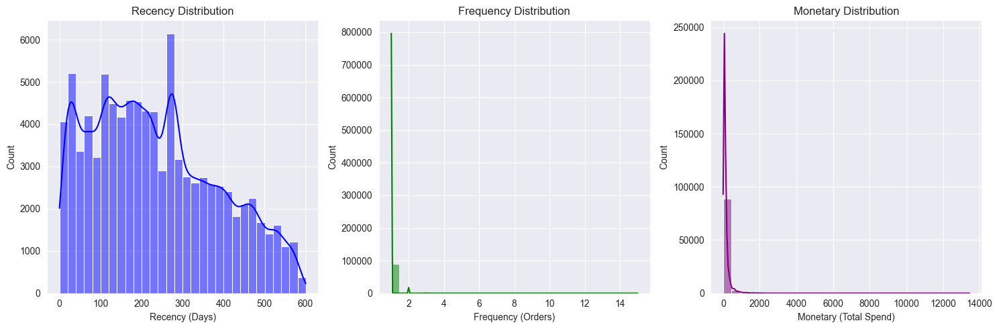

In [89]:
# Set figure size
plt.figure(figsize=(15, 5))

# Recency Distribution
plt.subplot(1, 3, 1)
sns.histplot(rfm['Recency'], bins=30, kde=True, color='blue')
plt.xlabel('Recency (Days)')
plt.ylabel('Count')
plt.title('Recency Distribution')

# Frequency Distribution
plt.subplot(1, 3, 2)
sns.histplot(rfm['Frequency'], bins=30, kde=True, color='green')
plt.xlabel('Frequency (Orders)')
plt.ylabel('Count')
plt.title('Frequency Distribution')

# Monetary Distribution
plt.subplot(1, 3, 3)
sns.histplot(rfm['Monetary'], bins=30, kde=True, color='purple')
plt.xlabel('Monetary (Total Spend)')
plt.ylabel('Count')
plt.title('Monetary Distribution')

# Show plots
plt.tight_layout()
plt.show()

### **5.4.1 Recency Segmentation**

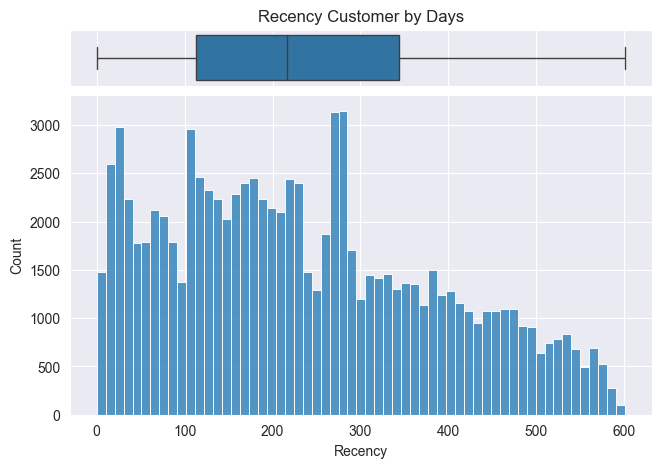

0.00      0.0
0.25    113.0
0.50    217.0
0.75    344.0
1.00    601.0
Name: Recency, dtype: float64

In [90]:
fig, (ax_top, ax_bot) = plt.subplots(
                            nrows=2, 
                            ncols=1, 
                            figsize=(7.5, 5),
                            gridspec_kw={
                                'height_ratios': (0.15, 0.85),
                                'hspace': 0.05
                            }
                        )

sns.boxplot(data=rfm, x='Recency', ax=ax_top)
sns.histplot(data=rfm, x='Recency', ax=ax_bot)

ax_top.set(
    title='Recency Customer by Days'
)

plt.show()
display(rfm['Recency'].quantile([0, 0.25, 0.5, 0.75, 1]))

Based on the distribution above, we will categorize customers into four groups based on their recency:

•	4 (Active): Made a transaction within the last 113 days

•	3 (Warm): Made a transaction between 113 and 217 days ago

•	2 (Cold): Made a transaction between 217 and 344 days ago

•	1 (Inactive): Made a transaction more than 344 days ago

In [91]:
rfm['R_score'] = pd.qcut(rfm['Recency'], q=4, labels=[4, 3, 2, 1]).astype(int)


In [94]:
rfm.sample(5, random_state=rs)

,customer_unique_id,Recency,Frequency,Monetary,R_score
9129,18d74c0ec7d4dece2cac2f292823a5a6,164,1,47.65,3
73159,c8c88e0a42d805d7e476ddd386bd737f,93,1,55.99,4
77030,d359203c0eb99c5c27bc7dae77bd586d,376,1,59.98,1
87307,efdde190794fc1f7e2d1c91dda5453fe,525,1,98.00,1
71963,c598e7b13c0fc6b1820559eabaadb3ab,378,1,169.90,1


In [95]:
rfm.sample(10)

,customer_unique_id,Recency,Frequency,Monetary,R_score
68463,bbebe4b8eb77c193d602f15005347dd6,262,1,69.99,2
70823,c2437c121c5840db3d5796efb6242aae,77,1,144.00,4
89215,f523f26dbffe20b9e4966210bf8fe8ec,395,1,97.90,1
32400,58b543fb88ff2dd1af70029acb7fedf9,37,1,45.20,4
19225,349eebf90d7966610f93da0df77c304b,399,1,205.00,1
30996,54ff772cbecbee133abce5bfbbf2bdd9,175,1,193.00,3
4774,0d086121374abc7682c5ec5bc50373b6,376,1,169.00,1
70778,c223b7ac9fead9ac6517fae001822112,174,1,49.95,3
21748,3b8e35acc6e08d9146f097dc1efbf471,295,1,89.90,2
2506,06dea25f72464d360d2ae75b42fa492a,257,1,200.00,2


### **5.4.2 Frequency Segmentation**

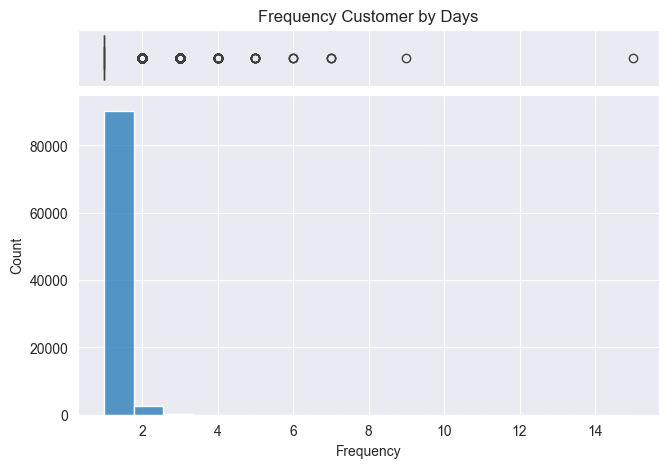

0.00     1.0
0.25     1.0
0.50     1.0
0.75     1.0
1.00    15.0
Name: Frequency, dtype: float64

In [96]:
fig, (ax_top, ax_bot) = plt.subplots(
                            nrows=2, 
                            ncols=1, 
                            figsize=(7.5, 5),
                            gridspec_kw={
                                'height_ratios': (0.15, 0.85),
                                'hspace': 0.05
                            }
                        )

sns.boxplot(data=rfm, x='Frequency', ax=ax_top)
sns.histplot(data=rfm, x='Frequency', ax=ax_bot)

ax_top.set(
    title='Frequency Customer by Days'
)

plt.show()
display(rfm['Frequency'].quantile([0, 0.25, 0.5, 0.75, 1]))

In [97]:
rfm["Frequency"].value_counts()

Frequency
1     90310
2      2568
3       178
4        30
5         9
6         3
7         3
9         1
15        1
Name: count, dtype: int64

As the data is highly skewed to the most part of data has a frequency of 1, we will manually define these bins instead of using pd.qcut to ensure a more meaningful segmentation.

We will categorize customers into four groups based on their transaction frequency, using the following criteria:

•	4 (Loyal): 5 and more transactions

•	3 (High): 3 to 4 transactions

•	2 (Medium): 2 transactions

•	1 (Low): Only 1 transaction


In [98]:
def f_score(x):
    if x<=1:
        return 1
    elif x == 2:
        return 2
    elif x <= 4:
        return 3
    else:
        return 4
    
rfm['F_score'] = rfm['Frequency'].apply(f_score)
rfm.sample(5, random_state=42)

,customer_unique_id,Recency,Frequency,Monetary,R_score,F_score
9129,18d74c0ec7d4dece2cac2f292823a5a6,164,1,47.65,3,1
73159,c8c88e0a42d805d7e476ddd386bd737f,93,1,55.99,4,1
77030,d359203c0eb99c5c27bc7dae77bd586d,376,1,59.98,1,1
87307,efdde190794fc1f7e2d1c91dda5453fe,525,1,98.00,1,1
71963,c598e7b13c0fc6b1820559eabaadb3ab,378,1,169.90,1,1


In [99]:
rfm['F_score'] = rfm['F_score'].astype(int)

In [100]:
rfm.sample(5, random_state=rs)

,customer_unique_id,Recency,Frequency,Monetary,R_score,F_score
9129,18d74c0ec7d4dece2cac2f292823a5a6,164,1,47.65,3,1
73159,c8c88e0a42d805d7e476ddd386bd737f,93,1,55.99,4,1
77030,d359203c0eb99c5c27bc7dae77bd586d,376,1,59.98,1,1
87307,efdde190794fc1f7e2d1c91dda5453fe,525,1,98.00,1,1
71963,c598e7b13c0fc6b1820559eabaadb3ab,378,1,169.90,1,1


### **5.4.3 Monetary Segmentation**

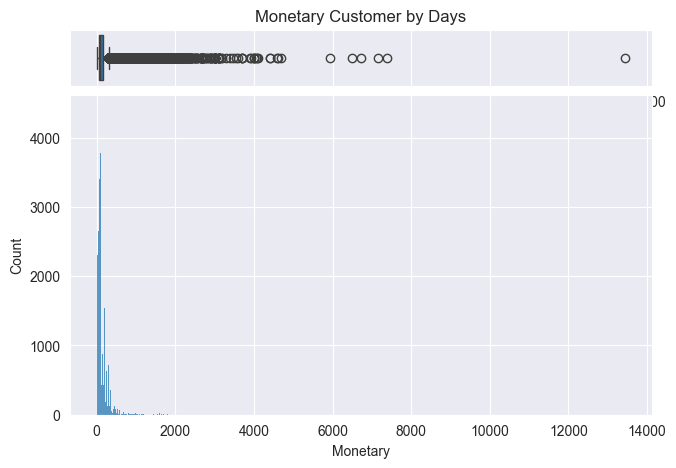

0.00        0.85
0.25       47.90
0.50       89.80
0.75      155.97
1.00    13440.00
Name: Monetary, dtype: float64

In [101]:
fig, (ax_top, ax_bot) = plt.subplots(
                            nrows=2, 
                            ncols=1, 
                            figsize=(7.5, 5),
                            gridspec_kw={
                                'height_ratios': (0.15, 0.85),
                                'hspace': 0.05
                            }
                        )

sns.boxplot(data=rfm, x='Monetary', ax=ax_top)
sns.histplot(data=rfm, x='Monetary', ax=ax_bot)

ax_top.set(
    title='Monetary Customer by Days'
)

plt.show()
display(rfm['Monetary'].quantile([0, 0.25, 0.5, 0.75, 1]))

We will divides the Monetary values into 4 equal-sized quartiles (each containing ~25% of the data).

In [102]:
rfm['M_score'] = pd.qcut(rfm['Monetary'], q=4, labels=[1, 2, 3, 4]).astype(int)

In [103]:
rfm.sample(5, random_state=rs)

,customer_unique_id,Recency,Frequency,Monetary,R_score,F_score,M_score
9129,18d74c0ec7d4dece2cac2f292823a5a6,164,1,47.65,3,1,1
73159,c8c88e0a42d805d7e476ddd386bd737f,93,1,55.99,4,1,2
77030,d359203c0eb99c5c27bc7dae77bd586d,376,1,59.98,1,1,2
87307,efdde190794fc1f7e2d1c91dda5453fe,525,1,98.00,1,1,3
71963,c598e7b13c0fc6b1820559eabaadb3ab,378,1,169.90,1,1,4


Separate R,F,M score give us quantitative information, but businesses need actionable insights. By grouping customers into meaningful segments, we can:
- Identify high-value customers to reward them.
- Spot at-risk customers to win them back.
- Understand customer purchasing behavior to personalize marketing strategies.

## **5.5 Customer Segmentation Methods**

There are two methods commonly used in customer segmentation analysis, which are : 

1. Total Score 
2. Combined Individual Score

We will explore this two method and find which one works better for Olist's targeted marketing

### **5.5.1 Total Score**

We will sum the individual R, F, and M scores to get a Total Score (R_score + F_score + M_score.After that customers are grouped based on their total score. This method is simple to implement and interpret.

In [104]:
rfm['RFM_total'] =rfm['R_score'] + rfm['F_score'] + rfm['M_score']
rfm.sample(5, random_state=42)

,customer_unique_id,Recency,Frequency,Monetary,R_score,F_score,M_score,RFM_total
9129,18d74c0ec7d4dece2cac2f292823a5a6,164,1,47.65,3,1,1,5
73159,c8c88e0a42d805d7e476ddd386bd737f,93,1,55.99,4,1,2,7
77030,d359203c0eb99c5c27bc7dae77bd586d,376,1,59.98,1,1,2,4
87307,efdde190794fc1f7e2d1c91dda5453fe,525,1,98.00,1,1,3,5
71963,c598e7b13c0fc6b1820559eabaadb3ab,378,1,169.90,1,1,4,6


| **Total Score Range** | **Segment Name**               |
|----------------------|------------------------------|
| **3 - 4**           | 8. Lost Customers            |
| **5 - 6**           | 7. At Risk Customers         |
| **7 - 8**           | 6. Need Attention Customers  |
| **9 - 10**          | 5. Big Spenders              |
| **11**              | 4. New Customers             |
| **12 - 13**         | 3. Potential Loyalists       |
| **14 - 15**         | 2. Loyal Customers           |
| **16 - 17**         | 1. Best Customers            |

In [105]:
# Define new bins for 8-segment Total Score approach
bins = [2, 4, 6, 8, 10, 11, 13, 15, 17]  
labels = [
    '8. Lost Customers', 
    '7. At Risk Customers', 
    '6. Need Attention Customers', 
    '5. Big Spenders',
    '4. New Customers',
    '3. Potential Loyalists',
    '2. Loyal Customers', 
    '1. Best Customers'
]

# Apply segmentation to Total Score
rfm['TS_Segment'] = pd.cut(rfm['RFM_total'], bins=bins, labels=labels)

# Display segment distribution
rfm['TS_Segment'].value_counts()

TS_Segment
7. At Risk Customers           40129
6. Need Attention Customers    29120
8. Lost Customers              17310
5. Big Spenders                 6467
4. New Customers                  70
3. Potential Loyalists             7
2. Loyal Customers                 0
1. Best Customers                  0
Name: count, dtype: int64

/var/folders/cr/hz35zl7n47s127kxhzszt_wc0000gn/T/ipykernel_92903/4122124144.py:1: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  rfm_heatmap = rfm.pivot_table(index='TS_Segment', values=['Recency', 'Frequency', 'Monetary'], aggfunc='median')


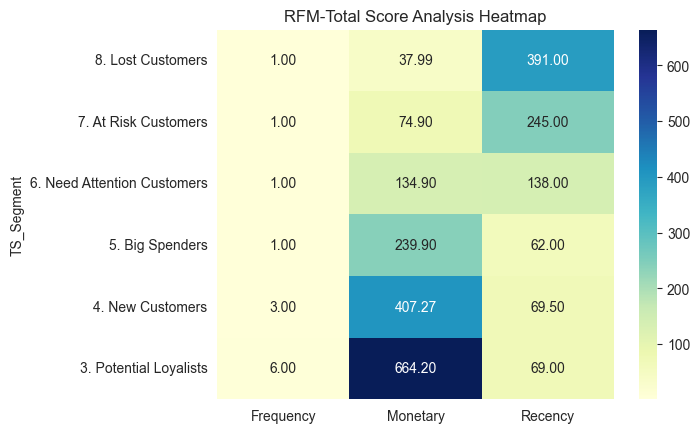

In [106]:
rfm_heatmap = rfm.pivot_table(index='TS_Segment', values=['Recency', 'Frequency', 'Monetary'], aggfunc='median')

# Create the heatmap
sns.heatmap(rfm_heatmap, cmap='YlGnBu', annot=True, fmt=".2f")
plt.title('RFM-Total Score Analysis Heatmap')
plt.show()

Total Score sums R, F, and M and does not prioritize Recency, Frequency, or Monetary separately. 

In the above, trying to segment customers into 8 segments using the Total Score approach, it resulted in several segments—particularly “Best Customers” and “Loyal Customers”—remaining unpopulated. 

This occurs because achieving very high total scores (such as those needed for “Best” or “Loyal” segments) requires customers to have simultaneously high scores across all three dimensions, which can be uncommon, especially with skewed datasets like Olist.

We will try to reduce the number of segments from 8 to 4 for the Total Score approach. 

| Total Score Range | Segment Name       | Description                                       |
|------------------|-------------------|-------------------------------------------------|
| **10 - 12**      | **Best Customers**  | High recency, frequency, and spending           |
| **7 - 9**        | **Loyal Customers** | Moderate to high engagement                     |
| **4 - 6**        | **At Risk Customers** | Low frequency or monetary value                 |
| **3**            | **Lost Customers**  | No recent transactions, low frequency & spending |

In [107]:
bins = [2, 3, 6, 9, 12] 
labels = ['4. Lost Customers', '3. At Risk Customers', '2. Loyal Customers', '1. Best Customers']

rfm['TS_Segment'] = pd.cut(rfm['RFM_total'], bins=bins, labels=labels)
rfm['TS_Segment'].value_counts()

TS_Segment
3. At Risk Customers    51538
2. Loyal Customers      35111
4. Lost Customers        5901
1. Best Customers         553
Name: count, dtype: int64

/var/folders/cr/hz35zl7n47s127kxhzszt_wc0000gn/T/ipykernel_92903/4122124144.py:1: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  rfm_heatmap = rfm.pivot_table(index='TS_Segment', values=['Recency', 'Frequency', 'Monetary'], aggfunc='median')


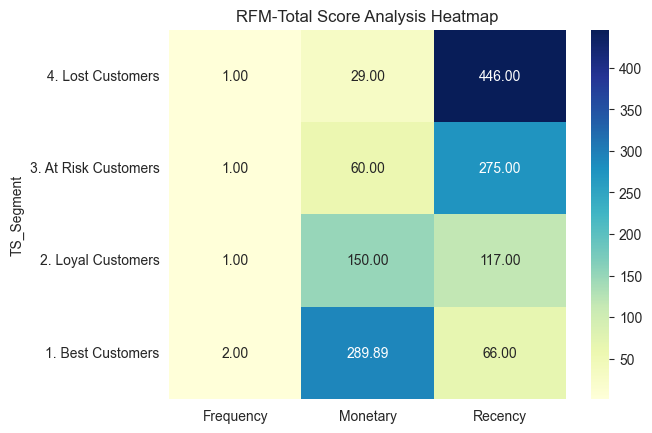

In [108]:
rfm_heatmap = rfm.pivot_table(index='TS_Segment', values=['Recency', 'Frequency', 'Monetary'], aggfunc='median')

# Create the heatmap
sns.heatmap(rfm_heatmap, cmap='YlGnBu', annot=True, fmt=".2f")
plt.title('RFM-Total Score Analysis Heatmap')
plt.show()

We can see that in terms of the monetary, the customer segmentation can separate the high and low monetary customer. The heatmap shows a high recency (activity) in lost customer, this is because the lost customer is highly populated, not because the lost customer is active recently. 

Using this segmentation, still not enough to gain a good marketing insights to targeted marketing strategies in Olist. 

We will further explore the combined score approach.

### **5.5.2 Combined Individual Score**

Using this method, instead of summing the scores, we can create specific customer segments based on their combinations of R_score, F_score, and M_score according to Olist's preference on its customer segmentation. This method actually provides more detailed segmentation and can align with Olist's unique business goals.

RFM segmentation is not a one-size-fits-all model. The number of customer segments should be tailored to the company’s industry, business goals, and customer behavior.

Creating too many micro-segments can lead to overly complex marketing campaigns, diminishing returns, and operational hassles. In general, business should start with a manageable number of segments. In this project, we will create 8 segments and then evaluate Olist's segmentation approach as we go.

Reff [5]

Reff [6]

[5]:https://clevertap.com/blog/rfm-ecommerce/#:~:text=RFM%20customer%20segmentation—an%20approach,purchase%20patterns%2C%20and%20overall%20spending.

[6]:https://how-many-steps-inc.webflow.io/rfm-segmentation-overview?utm_source=chatgpt.com

| Segment Name                 | RFM Score Combinations                                      | Explanation |
|------------------------------|------------------------------------------------------------|-------------|
| **Best Customers**           | 344, 434, 443, 444                                         | Recently active, frequent buyers, high spenders |
| **Loyal Customers**          | 333, 334, 343, 433, 442, 441                              | Frequent shoppers, good spending habits |
| **Potential Loyalists**      | 233, 243, 322, 323, 324, 332, 341, 342, 423, 432          | Recent customers with strong spending & frequency |
| **New Customers**            | 411, 412, 421, 422, 424, 413                              | Recently purchased but not frequent or high spenders |
| **Big Spenders**             | 144, 234, 244, 344, 414, 314                              | Not recent, but historically high spending & frequent |
| **Need Attention Customers** | 242, 133, 134, 143, 214, 213, 222, 223, 224, 232, 311, 313, 321, 331, 312 | Customers with declining engagement who may need re-engagement efforts |
| **At-Risk Customers**        | 122, 114, 123, 132, 141, 142, 211, 221, 231, 241, 124, 212 | Previously good customers who are now inactive |
| **Lost Customers**           | 111, 121, 112, 131, 113                                   | Long inactive, low frequency, and low spending |

In [109]:
rfm['RFM_Combined'] = rfm['R_score'].astype(str) + rfm['F_score'].astype(str) + rfm['M_score'].astype(str)

In [110]:
# Define function to classify customers into segments with numeric labels
def assign_rfm_segment(df):
    rfm_score = df['RFM_Combined']

    if rfm_score in {'344','434','443','444'}:
        return '1. Best Customers'
    elif rfm_score in {'333','334','343','433','442','441'}:
        return '2. Loyal Customers'
    elif rfm_score in {'233','243','322','323','324','332','341','342','423','432'}:
        return '3. Potential Loyalists'
    elif rfm_score in {'411','412','421','422','424','413'}:
        return '4. New Customers'
    elif rfm_score in {'144','234','244','344','414','314'}:
        return '5. Big Spenders'
    elif rfm_score in {'242','133','134','143','214','213','222','223','224','232','311','313','321','331','312'}:
        return '6. Need Attention Customers'
    elif rfm_score in {'122','114','123','132','141','142','211','221','231','241','124','212'}:
        return '7. At Risk Customers'
    elif rfm_score in {'111', '121', '112', '131','113'}:
        return '8. Lost Customers'
    else:
        return 'Other'  # For unexpected values (optional safety check)

# Apply function to RFM data
rfm['CIS_Segment'] = rfm.apply(assign_rfm_segment, axis=1)

In [111]:
rfm["CIS_Segment"].value_counts()   

CIS_Segment
6. Need Attention Customers    28728
4. New Customers               17896
7. At Risk Customers           17620
8. Lost Customers              17190
5. Big Spenders                10693
3. Potential Loyalists           837
1. Best Customers                 77
2. Loyal Customers                62
Name: count, dtype: int64

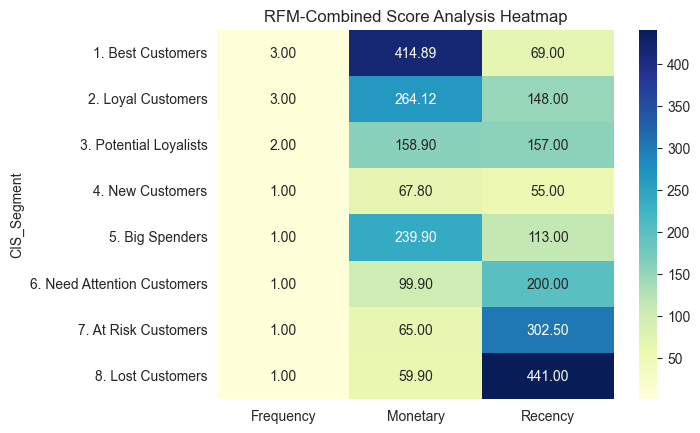

In [112]:
rfm_heatmap = rfm.pivot_table(index='CIS_Segment', values=['Recency', 'Frequency', 'Monetary'], aggfunc='median')

# Create the heatmap
sns.heatmap(rfm_heatmap, cmap='YlGnBu', annot=True, fmt=".2f")
plt.title('RFM-Combined Score Analysis Heatmap')
plt.show()

Using the Combined Individual Score (CIS) approach in RFM segmentation is more suitable for Olist’s marketing strategy because it allows for a more detailed understanding of customer behavior within each segment.

For example, in the “Big Spenders” segment, even if customers have low frequency and recency, they are still categorized as high-value customers due to their top 3 monetary contribution among all customer segments.

This insight is crucial for the marketing team as it helps identify customers who, despite lower engagement, have the potential to generate significant revenue if nurtured properly. By recognizing these customers early, Olist can implement targeted retention strategies, such as exclusive offers, loyalty programs, and premium customer services to maximize their lifetime value and encourage repeat purchases.

In [113]:
color_map = {
    '1. Best Customers' : 'gray',
    '2. Loyal Customers' : 'purple',
    '3. Potential Loyalists' : 'pink',
    '4. New Customers' : 'blue',
    '5. Big Spenders' : 'green',
    '6. Need Attention Customers' : 'yellow', 
    '7. At Risk Customers' : 'orange', 
    '8. Lost Customers' : 'red',
}

fig = px.scatter_3d(
    rfm, 
    x='Recency', 
    y='Frequency', 
    z='Monetary',
    color='CIS_Segment', 
    color_discrete_map=color_map, 
)
                          
fig.update_traces(marker_size = 3)

# tight layout
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0),
                  title={
                    'text': "RFM Segmentation (Combined Score)",
                    'y':0.97,
                    'x':0.45,
                    'xanchor': 'center',
                    'yanchor': 'top'},
                    legend=dict(
                      yanchor="top",
                      y=0.97,
                      xanchor="left",
                      x=0.70,
                      itemsizing='constant',
                      itemwidth = 30))

fig.update_xaxes(tickformat=".0f")

In [114]:
import plotly.express as px

# Count the number of customers in each segment
rfm_counts = rfm['CIS_Segment'].value_counts().reset_index()
rfm_counts.columns = ['Segment', 'Count']

# Create pie chart
fig = px.pie(
    rfm_counts, 
    names='Segment', 
    values='Count',
    title="RFM Segmentation - Percentage Distribution",
    color='Segment', 
    color_discrete_map=color_map  # Use your predefined color mapping
)

# Show the figure
fig.show()

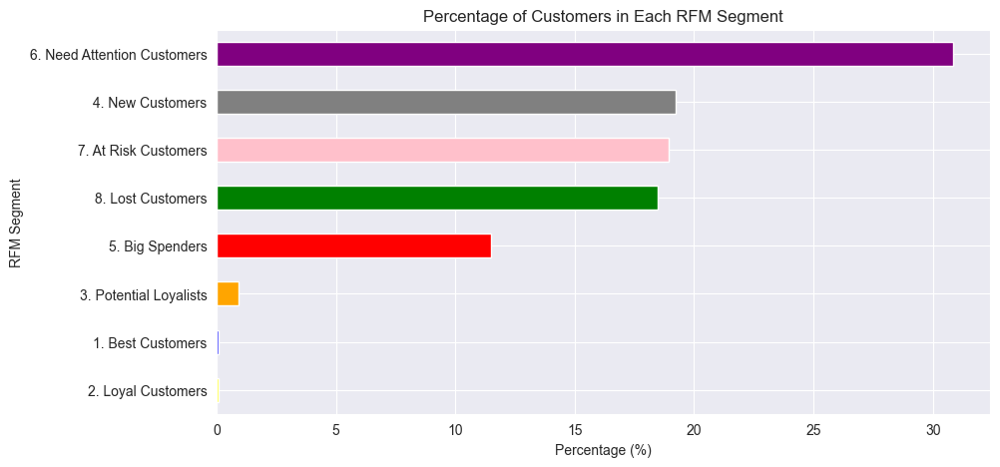

In [115]:
import matplotlib.pyplot as plt

# Count customers per segment
rfm_counts = rfm['CIS_Segment'].value_counts(normalize=True) * 100  # Convert to percentage

# Plot bar chart
plt.figure(figsize=(10, 5))
rfm_counts.sort_values().plot(kind='barh', color=[color_map.get(x, 'gray') for x in rfm_counts.index])
plt.xlabel('Percentage (%)')
plt.ylabel('RFM Segment')
plt.title('Percentage of Customers in Each RFM Segment')
plt.show()

RFM segmentation using the **Combined Individual Score (CIS) Approach** allows Olist to classify customers into **eight meaningful groups** based on their **Recency, Frequency, and Monetary behavior**. This segmentation helps the marketing team **identify key customer groups** and apply **targeted strategies** to improve engagement, retention, and revenue.

- **Best & Loyal Customers** are the most valuable and frequent buyers, requiring **VIP programs, loyalty rewards, and personalized offers**.
- **Potential Loyalists & New Customers** show growth potential and should be nurtured through **onboarding, special discounts, and engagement campaigns**.
- **Big Spenders** contribute high revenue but buy less frequently, benefiting from **exclusive deals and premium services**.
- **Need Attention & At-Risk Customers** have declining activity and require **re-engagement efforts, win-back campaigns, and personalized incentives**.
- **Lost Customers** have been inactive for a long time; marketing efforts should focus only on **high-value former customers**.

By **understanding customer behaviors and targeting segments effectively**, Olist can **optimize marketing efforts**, maximize customer lifetime value, and reduce churn.

# **6. Recommendation System**

To further support the marketing team, we will develop a recommendation system to suggest suitable products for Olist customers. This system aims to enhance customer experience, increase engagement, and ultimately boost customer retention by recommending products that align with user interests.


## **6.1 Recommendation System Data Preparation**

In [116]:
df_rs = df_merge[["customer_unique_id","product_id","product_category_name_english","review_score"]]

In [117]:
df_rs.isna().sum()

customer_unique_id               0
product_id                       0
product_category_name_english    0
review_score                     0
dtype: int64

In [118]:
df_rs.dtypes

customer_unique_id               object
product_id                       object
product_category_name_english    object
review_score                      int64
dtype: object

Our dataset does not provide specific product names, but it does contain product category names. However, since multiple products can belong to the same category, using only the category name would make it impossible to differentiate the recommendation results between individual products.

To solve this, we:
-  Cleaned the product category names to make them more readable.
-  Added a unique number to each product within a category to ensure each product can still be uniquely identified

In [119]:
df_rs['product_category_name_cleaned'] = df_rs['product_category_name_english'].str.replace('_', ' ')
df_rs = df_rs.sort_values(by=['product_id', 'product_category_name_cleaned'])

/var/folders/cr/hz35zl7n47s127kxhzszt_wc0000gn/T/ipykernel_92903/3533051855.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [120]:
df_product_labels = df_rs[['product_id', 'product_category_name_cleaned']].drop_duplicates()
df_product_labels['product_category_numbered'] = df_product_labels.groupby('product_category_name_cleaned').cumcount() + 1
df_product_labels['product_category_labeled'] = df_product_labels['product_category_name_cleaned'] + " " + df_product_labels['product_category_numbered'].astype(str)

In [121]:
df_rs = df_rs.merge(df_product_labels[['product_id', 'product_category_labeled']], on='product_id', how='left')

In [122]:
df_rs.sample(3)

,customer_unique_id,product_id,product_category_name_english,review_score,product_category_name_cleaned,product_category_labeled
72858,1b9c191439df93697089504c628ca951,a8fe47ad6f852f93cc92c7b408687de3,sports_leisure,5,sports leisure,sports leisure 1827
6571,fc128a4fe9079758a234b36379013c26,0fa81e7123fd0ebe03adbbe99d912827,bed_bath_table,5,bed bath table,bed bath table 185
15161,8a8b0c59da609d6812f5dab9a46ce1c8,23b156533f31f1e4493d605705f7e6db,stationery,5,stationery,stationery 119


In [123]:
df_rs.groupby('product_category_name_cleaned')['product_id'].nunique()

product_category_name_cleaned
agro industry and commerce      74
air conditioning               120
art                             54
arts and craftmanship           19
audio                           56
                              ... 
stationery                     846
tablets printing image           8
telephony                     1118
toys                          1392
watches gifts                 1318
Name: product_id, Length: 71, dtype: int64

In [124]:
df_rs["product_category_labeled"].nunique()

32008

In [125]:
df_rs["product_id"].nunique()

32008

## **6.2 Similarity-Based Methods**

To enhance customer engagement and retention, we will try implement a recommendation system using similarity-based methods. <Br>

Similarity-based recommendation systems are a type of collaborative filtering that rely on finding similarities between users or items to generate recommendations. These methods assume that similar users like similar items or that similar items are often bought together. <br>

We use Collaborative Filtering, which finds patterns in past interactions:

•	User-Based Collaborative Filtering (UBCF): Recommends products based on similar users’ purchasing behaviors.

•	Item-Based Collaborative Filtering (IBCF): Suggests similar products based on what customers frequently buy together.


### **6.2.1 User-Based Collaborative Filtering (UBCF)**

User-Based Collaborative Filtering (UBCF) is a recommender system technique that suggests products (or other items) to a user based on the preferences and behaviors of similar users. Instead of analyzing the features of products, this method focuses on user interactions and purchase patterns, making recommendations by identifying users with similar interests. <br>

Since our matrix would have 2.98 billion (2,980,040,824) cells, it is not feasible to process directly. Instead, we apply random sampling to reduce the dataset size while maintaining a representative sample of user-product interactions. <br>

Random sampling is the easiest and most common way to pick data for recommender systems. It means choosing a random group of users and items from the original dataset, without any specific pattern or preference. This method helps reduce the time and memory needed for machine learning models and prevents overfitting and unnecessary noise. However, it also has downsides, like missing important information and making recommendations less diverse. We should keep this in mind for future improvements.

[Reff][7]

[7]:https://www.linkedin.com/advice/3/what-most-effective-sampling-methods-recommender-ja97f

In [126]:
SAMPLE_FRACTION = 0.55 # Adjust as needed

# Get unique users
unique_users = df_rs['customer_unique_id'].unique()

# Randomly sample users
sampled_users = pd.Series(unique_users).sample(frac=SAMPLE_FRACTION, random_state=42)

# Filter dataset to only include sampled users
df_sampled = df_rs[df_rs['customer_unique_id'].isin(sampled_users)]

# Display new dataset size
print(f"Original Dataset: {df_rs.shape[0]}")
print(f"Sampled Dataset: {df_sampled.shape[0]}")

Original Dataset: 110379
Sampled Dataset: 60796


In [127]:
df_sampled = df_sampled.groupby(['customer_unique_id', 'product_id'], as_index=False)['review_score'].mean()

In [128]:
user_item_matrix = df_sampled.pivot(index='customer_unique_id', columns='product_id', values='review_score')
user_item_matrix = user_item_matrix.fillna(0)

print(f"User-Item Matrix Shape: {user_item_matrix.shape}")
user_item_matrix.head()

User-Item Matrix Shape: (51207, 21998)


product_id,00066f42aeeb9f3007548bb9d3f33c38,000b8f95fcb9e0096488278317764d19,0011c512eb256aa0dbbb544d8dffcf6e,00126f27c813603687e6ce486d909d01,001795ec6f1b187d37335e1c4704762e,001b72dfd63e9833e8c02742adf472e3,00210e41887c2a8ef9f791ebc780cc36,002159fe700ed3521f46cfcf6e941c76,0021a87d4997a48b6cef1665602be0f5,00250175f79f584c14ab5cecd80553cd,...,ffe9468f4d890db80b7231e86931ff37,ffeb228c521d5464d1f71444da96c446,ffedbd68fa6f44e788ff6c2db8094715,ffef256879dbadcab7e77950f4f4a195,fff0a542c3c62682f23305214eaeaa24,fff1059cd247279f3726b7696c66e44e,fff6177642830a9a94a0f2cba5e476d1,fff9553ac224cec9d15d49f5a263411f,fffdb2d0ec8d6a61f0a0a0db3f25b441,fffe9eeff12fcbd74a2f2b007dde0c58
customer_unique_id,,,,,,,,,,,,,,,,,,,,,
0000f6ccb0745a6a4b88665a16c9f078,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0004aac84e0df4da2b147fca70cf8255,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
00050ab1314c0e55a6ca13cf7181fecf,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
00082cbe03e478190aadbea78542e933,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
000949456b182f53c18b68d6babc79c1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


We've used sample fraction 55%. This is considered a good proportion for sampling and this percentage still successful for the system to run. 

After creating the User-Item Matrix, to generate recommendations, we need to measure how similar users are based on their interactions with products.

We use Cosine Similarity, which calculates the closeness of two users’ purchasing behavior based on the angle between their interaction vectors.

[Reff][8]

[8]:https://www.linkedin.com/advice/3/what-most-effective-sampling-methods-recommender-ja97f


In [129]:
# Convert the user-item matrix to a sparse matrix (for efficiency)
user_item_sparse = csr_matrix(user_item_matrix.values)

user_similarity = cosine_similarity(user_item_sparse)
user_similarity_df = pd.DataFrame(user_similarity, index=user_item_matrix.index, columns=user_item_matrix.index)

print("User Similarity Matrix Shape:", user_similarity_df.shape)
user_similarity_df.head()

User Similarity Matrix Shape: (51207, 51207)


customer_unique_id,0000f6ccb0745a6a4b88665a16c9f078,0004aac84e0df4da2b147fca70cf8255,00050ab1314c0e55a6ca13cf7181fecf,00082cbe03e478190aadbea78542e933,000949456b182f53c18b68d6babc79c1,000bfa1d2f1a41876493be685390d6d3,000ed48ceeb6f4bf8ad021a10a3c7b43,0010a452c6d13139e50b57f19f52e04e,001147e649a7b1afd577e873841632dd,0011805441c0d1b68b48002f1d005526,...,fff3a9369e4b7102fab406a334a678c3,fff3e1d7bc75f11dc7670619b2e61840,fff5eb4918b2bf4b2da476788d42051c,fff7219c86179ca6441b8f37823ba3d3,fff96bc586f78b1f070da28c4977e810,fffa431dd3fcdefea4b1777d114144f2,fffcc512b7dfecaffd80f13614af1d16,fffea47cd6d3cc0a88bd621562a9d061,ffff5962728ec6157033ef9805bacc48,ffffd2657e2aad2907e67c3e9daecbeb
customer_unique_id,,,,,,,,,,,,,,,,,,,,,
0000f6ccb0745a6a4b88665a16c9f078,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0004aac84e0df4da2b147fca70cf8255,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
00050ab1314c0e55a6ca13cf7181fecf,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
00082cbe03e478190aadbea78542e933,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
000949456b182f53c18b68d6babc79c1,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


A csr_matrix (Compressed Sparse Row Matrix) is a memory-efficient representation of sparse data,especially for large user-item matrices. Instead of storing all values (including zeros), a CSR matrix :

- Stores only non-zero values, reducing memory usage.
- Enables fast operations on large datasets.
- Is widely used in recommendation systems and machine learning.


In [130]:
def recommend_user_based(target_user, n_recommendations=5):
    if target_user not in user_similarity_df.index:
        return f"Sorry, no recommendations available for user {target_user}. Try exploring popular products!"

    similar_users = user_similarity_df[target_user].drop(target_user).sort_values(ascending=False)
    top_similar_users = similar_users.head(3).index  
    similar_users_items = user_item_matrix.loc[top_similar_users].mean(axis=0)
    user_rated_products = user_item_matrix.loc[target_user][user_item_matrix.loc[target_user] > 0].index
    recommended_product_ids = similar_users_items.drop(user_rated_products).sort_values(ascending=False).head(n_recommendations).index
    product_mapping = df_rs[['product_id', 'product_category_labeled']].drop_duplicates().set_index('product_id')['product_category_labeled']
    
    recommended_categories = product_mapping.loc[recommended_product_ids].tolist()[:n_recommendations]

    return recommended_categories

In [131]:
user_id = "f7160a9c652b910d9771ad9eb2998da2"  
recommendations = recommend_user_based(user_id)
print(f"Recommended products for user {user_id}: {recommendations}")

Recommended products for user f7160a9c652b910d9771ad9eb2998da2: Sorry, no recommendations available for user f7160a9c652b910d9771ad9eb2998da2. Try exploring popular products!


In [132]:
user_id = "0000f6ccb0745a6a4b88665a16c9f078"  
recommendations = recommend_user_based(user_id)
print(f"Recommended products for user {user_id}: {recommendations}")

Recommended products for user 0000f6ccb0745a6a4b88665a16c9f078: ['telephony 859', 'housewares 810', 'housewares 594', 'perfumery 1', 'sports leisure 1862']


For customer with user_id "0000f6ccb0745a6a4b88665a16c9f078", the mix of telephony, housewares, perfumery, and sports leisure suggests that this user has diverse shopping interests.

Since multiple housewares items are recommended, it indicates that similar users purchased multiple products from this category. <br>

The marketing team can use these recommendations to : 

- Personalized Homepage Recommendations : Placing these items on the user’s homepage increases engagement.
- Category-Specific Promotions : If multiple users like this category mix, targeted promotions (for example, discounts on sports & electronics bundles) can drive conversions.
- Cross-Selling Opportunity : Users who buy housewares may also be interested in perfumery and telephony items, allowing for better bundling strategies. <br>

In this case, if a user receives “Sorry, no recommendations available for user ”, it means that their user ID is not present in the similarity matrix (user_similarity_df). This can happen due to several reasons:

- The user was removed during sampling – Some users may have been excluded when reducing the dataset for efficiency.
- The user has too few interactions – If a user has interacted with very few products, the model may not have enough data to compute similarity.
- The user is new (Cold Start Problem) – If the user did not exist in the training dataset, the model does not have enough historical data to make recommendations.

The Cold Start Problem is a key limitation of User-Based Collaborative Filtering because recommendations rely on past interactions. Without prior purchase data, the system cannot determine relevant recommendations.

### **6.2.2 Item-Based Collaborative Filtering (IBCF)**

Item-Based Collaborative Filtering (IBCF) is a recommender system technique that suggests products to a user based on the similarities between items, rather than user behavior. Unlike User-Based Collaborative Filtering, which finds similar users, Item-Based Filtering identifies products that are frequently purchased together and recommends them to users. <br>

The same problem will occurs when creating the item-user matrix. Since the Olist dataset contains a large number of unique products, using 100% of the data in Item-Based Collaborative Filtering (IBCF) would lead to high computational costs and memory issues. To optimize performance, we apply random sampling by selecting 35% of the products while maintaining a representative dataset.

The sampling percentage (35%) is chosen based on system limitations, ensuring the model runs efficiently without exceeding memory constraints. According to Ricci et al. (2011) in Recommender Systems Handbook, sub-sampling is a common practice when dealing with large-scale recommendation systems, balancing computational efficiency and recommendation quality. <br>

This approach allows us to scale Item-Based CF while preserving meaningful recommendations for Olist customers. 

In [133]:
df_rs.head()

,customer_unique_id,product_id,product_category_name_english,review_score,product_category_name_cleaned,product_category_labeled
0,cd929c5ecff5fc60e9d808d33702e434,00066f42aeeb9f3007548bb9d3f33c38,perfumery,5,perfumery,perfumery 1
1,cbbeff6b693e69511cf9d059f4b71036,00088930e925c41fd95ebfe695fd2655,auto,4,auto,auto 1
2,f51fb63558e88eb3373773d106fa6880,0009406fd7479715e4bef61dd91f2462,bed_bath_table,1,bed bath table,bed bath table 1
3,4e32da06df703a2561f63e75b13f6260,000b8f95fcb9e0096488278317764d19,housewares,5,housewares,housewares 1
4,7f2dfd48dba158dbf61ba2ea631d93df,000b8f95fcb9e0096488278317764d19,housewares,5,housewares,housewares 1


In [134]:
df_sampled_item = df_rs.groupby(['product_id', 'customer_unique_id'], as_index=False)['review_score'].mean()

In [135]:
PRODUCT_SAMPLING_PERCENTAGE = 0.35
total_unique_products = df_rs["product_id"].nunique()
MAX_PRODUCTS = int(total_unique_products * PRODUCT_SAMPLING_PERCENTAGE)


print(f"Total Unique Products: {total_unique_products}")
print(f"Sampling {PRODUCT_SAMPLING_PERCENTAGE * 100:.0f}% -> MAX_PRODUCTS: {MAX_PRODUCTS}")

Total Unique Products: 32008
Sampling 35% -> MAX_PRODUCTS: 11202


In [136]:
top_products = df_sampled_item['product_id'].value_counts().nlargest(MAX_PRODUCTS).index

df_sampled_item = df_sampled_item[df_sampled_item['product_id'].isin(top_products)]
print(f"Reduced dataset: {df_sampled_item.shape[0]} interactions, {df_sampled_item['product_id'].nunique()} unique products")

Reduced dataset: 76820 interactions, 11202 unique products


In [137]:
item_user_matrix = df_sampled_item.pivot(index='product_id', columns='customer_unique_id', values='review_score')
item_user_matrix = item_user_matrix.fillna(0)

print(f"Item-User Matrix Shape: {item_user_matrix.shape}")
item_user_matrix.head()

Item-User Matrix Shape: (11202, 73352)


customer_unique_id,0000366f3b9a7992bf8c76cfdf3221e2,0000b849f77a49e4a4ce2b2a4ca5be3f,0000f46a3911fa3c0805444483337064,0000f6ccb0745a6a4b88665a16c9f078,0004bd2a26a76fe21f786e4fbd80607f,00050ab1314c0e55a6ca13cf7181fecf,00053a61a98854899e70ed204dd4bafe,0005e1862207bf6ccc02e4228effd9a0,0005ef4cd20d2893f0d9fbd94d3c0d97,0006fdc98a402fceb4eb0ee528f6a8d4,...,fff7219c86179ca6441b8f37823ba3d3,fff96bc586f78b1f070da28c4977e810,fffa431dd3fcdefea4b1777d114144f2,fffb09418989a0dbff854a28163e47c6,fffcc512b7dfecaffd80f13614af1d16,fffcf5a5ff07b0908bd4e2dbc735a684,fffea47cd6d3cc0a88bd621562a9d061,ffff371b4d645b6ecea244b27531430a,ffff5962728ec6157033ef9805bacc48,ffffd2657e2aad2907e67c3e9daecbeb
product_id,,,,,,,,,,,,,,,,,,,,,
001795ec6f1b187d37335e1c4704762e,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
001b72dfd63e9833e8c02742adf472e3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
00210e41887c2a8ef9f791ebc780cc36,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
002159fe700ed3521f46cfcf6e941c76,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
00250175f79f584c14ab5cecd80553cd,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [138]:
# Convert the matrix to a sparse format (for efficiency)
item_user_sparse = csr_matrix(item_user_matrix.values)
item_similarity = cosine_similarity(item_user_sparse)
item_similarity_df = pd.DataFrame(item_similarity, index=item_user_matrix.index, columns=item_user_matrix.index)

print("Item Similarity Matrix Shape:", item_similarity_df.shape)
item_similarity_df.head()

Item Similarity Matrix Shape: (11202, 11202)


product_id,001795ec6f1b187d37335e1c4704762e,001b72dfd63e9833e8c02742adf472e3,00210e41887c2a8ef9f791ebc780cc36,002159fe700ed3521f46cfcf6e941c76,00250175f79f584c14ab5cecd80553cd,004636c889c7c3dad6631f136b7fa082,005030ef108f58b46b78116f754d8d38,006baa9a5b8f95895f15273a35bc2664,007c63ae4b346920756b5adcad8095de,00878d953636afec00d3e85d55a12e7f,...,ffbe3df3856b1fef3fee8f1264105a89,ffc0b406806006602c5853b00ab5f7fd,ffc9caf33e2d1e9f44e3e06da19085f7,ffd2365fb8224dc66883df9351d65deb,ffd34459c21034d1da6df9800de0d7a3,ffd4bf4306745865e5692f69bd237893,ffedbd68fa6f44e788ff6c2db8094715,ffef256879dbadcab7e77950f4f4a195,fff0a542c3c62682f23305214eaeaa24,fffdb2d0ec8d6a61f0a0a0db3f25b441
product_id,,,,,,,,,,,,,,,,,,,,,
001795ec6f1b187d37335e1c4704762e,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
001b72dfd63e9833e8c02742adf472e3,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
00210e41887c2a8ef9f791ebc780cc36,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
002159fe700ed3521f46cfcf6e941c76,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
00250175f79f584c14ab5cecd80553cd,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [139]:
def recommend_item_based(target_product, n_recommendations=5):
    if target_product not in item_similarity_df.index:
        return "Product not found. Try exploring other popular products!"

    similar_products = item_similarity_df[target_product].sort_values(ascending=False)
    recommended_product_ids = similar_products.drop(target_product).head(n_recommendations).index
    product_mapping = df_rs[['product_id', 'product_category_labeled']].drop_duplicates().set_index('product_id')['product_category_labeled']
    recommended_categories = product_mapping.loc[recommended_product_ids].tolist()

    return recommended_categories[:n_recommendations]

In [140]:
df_sampled_item.sample(3)

,product_id,customer_unique_id,review_score
46318,7594c5fa74bceda1c2540003533a6e02,02abda54135beba6c872bc929d06be83,4.0
10131,19c91ef95d509ea33eda93495c4d3481,d9c71c881802a7ac4d34619f175e68ce,5.0
76875,c62b9187381d86ae031b0bac9ead4b3d,5072b38d1de83ef6b9c7c15983a0f731,5.0


In [141]:
product_id = "ab1f9387c0627dd24000bfbc54fdeee0" 

print(recommend_item_based(product_id))

['furniture decor 1215', 'electronics 318', 'auto 1271', 'consoles games 1', 'garden tools 510']


In [142]:
df_rs[df_rs['product_id'] == "ab1f9387c0627dd24000bfbc54fdeee0"].head(1)

,customer_unique_id,product_id,product_category_name_english,review_score,product_category_name_cleaned,product_category_labeled
73870,4a665a3b72a99832d62015e9721b1cac,ab1f9387c0627dd24000bfbc54fdeee0,electronics,5,electronics,electronics 347


Since Item-Based Collaborative Filtering (IBCF) recommends products based on items that are frequently bought together or have similar purchasing patterns, we can interpret the results as follows:

Recommendation for Product "ab1f9387c0627dd24000bfbc54fdeee0" (Electronics 347) is a mix from furniture decor, electronics, auto, console games, and garden tools. 

This means that customers who purchased “Electronics 347” also frequently interacted with these items. <Br>

Olist's marketing team can leverage these recomendation systems to create: 

-  Product Page Recommendations : These suggested products should appear as “Frequently Bought Together” or “Customers Also Bought” on the product page for "Electronics 347".
- Cross-Selling Strategy : If multiple electronics purchases correlate with furniture and automotive products, targeted ads and discounts on bundles could drive higher sales.
- Category-Based Personalization : Identifying trending cross-category purchases (like electronics + furniture) can help tailor promotions for different customer segments.


## **6.3 Model Based Method**

Other than the commonly used similarity based method, we will also explore the model-based methods. Unlike similarity-based methods (which rely on explicit similarities), model-based approaches learn hidden relationships between users and products through matrix factorization. 

Since Olist uses review scores as ratings, SVD is generally the better choice because it effectively predicts user preferences based on ratings. However, ALS remains valuable when working with purchase behavior data without explicit ratings.

So we will compare the two model.

### **6.3.1 SVD**

Singular Value Decomposition (SVD) is a matrix factorization technique used in recommendation systems to predict user preferences based on past interactions.

For example, if a user rated electronics highly, SVD can identify similar patterns in other users’ reviews and suggest related electronics they might like.


In [143]:
reader = Reader(rating_scale=(df_rs['review_score'].min(), df_rs['review_score'].max()))
data = Dataset.load_from_df(df_rs[['customer_unique_id', 'product_id', 'review_score']], reader)

In [144]:
trainset, testset = train_test_split(data, test_size=0.25, random_state=rs)

In [145]:
svd_model = SVD()
svd_model.fit(trainset)

In [146]:
# Predict ratings on the test set
predictions = svd_model.test(testset)

In [147]:
# Compute RMSE and MAE
rmse = accuracy.rmse(predictions)
mae = accuracy.mae(predictions)


RMSE: 1.2645
MAE:  0.9951


The Root Mean Squared Error (RMSE) = 1.2642 and Mean Absolute Error (MAE) = 0.9953 indicate how well the SVD model predicts review scores.

A lower RMSE and MAE would mean more accurate predictions, so there’s room for improvement.

We will now compare SVD with ALS to see if a different model performs better for our dataset.


### **6.3.2 ALS**

Alternating Least Squares (ALS) is a matrix factorization technique used in recommendation systems to predict user preferences based on implicit interactions (e.g., purchases, clicks, views).

ALS works by decomposing the user-item interaction matrix into two lower-dimensional matrices—user factors and item factors—by minimizing the error between actual and predicted interactions.

In [148]:
bsl_options = {'method': 'als',
               'n_epochs': 5,
               'reg_u': 12,
               'reg_i': 5
               }
asl = BaselineOnly(bsl_options=bsl_options)

asl.fit(trainset)
predictions = asl.test(testset)

Estimating biases using als...


In [149]:
# Compute RMSE and MAE
rmse = accuracy.rmse(predictions)
mae = accuracy.mae(predictions)


RMSE: 1.3097
MAE:  1.0421


The Root Mean Squared Error (RMSE) = 1.3097 and Mean Absolute Error (MAE) = 1.0421 indicate the prediction performance of the ALS model.

Compared to SVD (RMSE: 1.2642, MAE: 0.9953), ALS has slightly higher errors, meaning it is less accurate in predicting review scores.

Since SVD performs better, we will proceed with cross-validation for SVD to further refine its performance.

ALS may still be useful for implicit feedback scenarios (e.g., purchases without reviews), which can be considered in the future for Olist's improvement. But as for this dataset, SVD is the preferred model.

### **6.3.3 Model Tuning**

We will evaluate SVD across 5 different data splits, providing a more reliable performance measure.

In [150]:
cv_svd = cross_validate(svd_model, data, measures=['RMSE', 'MAE'], cv=5, verbose=True)

Evaluating RMSE, MAE of algorithm SVD on 5 split(s).

                  Fold 1  Fold 2  Fold 3  Fold 4  Fold 5  Mean    Std     
RMSE (testset)    1.2534  1.2658  1.2699  1.2577  1.2534  1.2601  0.0067  
MAE (testset)     0.9850  0.9943  0.9965  0.9877  0.9866  0.9900  0.0045  
Fit time          1.13    1.16    1.20    1.22    1.91    1.32    0.29    
Test time         0.08    0.08    0.08    0.34    0.09    0.13    0.10    


In [151]:
print('rmse cv mean',cv_svd['test_rmse'].mean())

rmse cv mean 1.2600620464158188


To further improve model accuracy, we will tune hyperparameters using GridSearchCV.


In [152]:
param_grid = {
    'n_epochs': [5, 15, 30],      # More training epochs
    'lr_all': [0.002, 0.005, 0.01], # Adjust learning rate
    'reg_all': [0.02, 0.05, 0.1]   # Adjust regularization
}

gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=5)
gs.fit(data)


| Parameter  | Description | Grid Search Values | Trade-offs |
|------------|------------|--------------------|------------|
| **`n_epochs`** | Number of training cycles | `[5, 15, 30]` | More epochs = better learning, but slower training |
| **`lr_all`** | Learning rate (step size for updating weights) | `[0.002, 0.005, 0.01]` | Higher = faster updates, but risk of instability |
| **`reg_all`** | Regularization (reduces overfitting) | `[0.02, 0.05, 0.1]` | Higher = prevents overfitting, but may oversimplify |


In [153]:
print("Best RMSE:", gs.best_score['rmse'])
print("Best MAE:", gs.best_score['mae'])

# Best parameters
print("Best Params:", gs.best_params['rmse'])

Best RMSE: 1.2174336579993397
Best MAE: 0.9196896115205314
Best Params: {'n_epochs': 30, 'lr_all': 0.01, 'reg_all': 0.02}


Comparing SVD before tuning and after tuning

In [154]:
#before
cv_default = cross_validate(svd_model, data, measures=['RMSE', 'MAE'], cv=5, verbose=True)

# print('rmse cv mean',cv_default['test_rmse'].mean())
print("**Default SVD:**")
print("RMSE (mean):", cv_default['test_rmse'].mean())
print("MAE (mean):", cv_default['test_mae'].mean())


Evaluating RMSE, MAE of algorithm SVD on 5 split(s).

                  Fold 1  Fold 2  Fold 3  Fold 4  Fold 5  Mean    Std     
RMSE (testset)    1.2630  1.2667  1.2549  1.2532  1.2663  1.2608  0.0057  
MAE (testset)     0.9927  0.9953  0.9843  0.9859  0.9964  0.9909  0.0049  
Fit time          1.20    1.18    1.16    1.17    1.18    1.18    0.01    
Test time         0.08    0.33    0.08    0.08    0.08    0.13    0.10    
**Default SVD:**
RMSE (mean): 1.2608057204846737
MAE (mean): 0.9909260376184298


In [155]:
#after
tuned_model = SVD(n_epochs = 30, lr_all = 0.01, reg_all = 0.02)
cv_tuned = cross_validate(tuned_model, data, measures=['RMSE', 'MAE'], cv=5, verbose=True)
print("\n **Tuned SVD:**")
print("RMSE (mean):", cv_tuned['test_rmse'].mean())
print("MAE (mean):", cv_tuned['test_mae'].mean())

Evaluating RMSE, MAE of algorithm SVD on 5 split(s).

                  Fold 1  Fold 2  Fold 3  Fold 4  Fold 5  Mean    Std     
RMSE (testset)    1.2077  1.2201  1.2233  1.2179  1.2166  1.2171  0.0052  
MAE (testset)     0.9128  0.9206  0.9251  0.9192  0.9183  0.9192  0.0040  
Fit time          1.58    1.57    1.62    1.60    1.60    1.59    0.02    
Test time         0.08    0.08    0.08    0.08    0.35    0.13    0.11    

 **Tuned SVD:**
RMSE (mean): 1.2171331784785218
MAE (mean): 0.9192041958599828


We will check if the model is overfitting or not by comparing to the train set.

In [156]:
from surprise.accuracy import rmse, mae

# Split data
trainset, testset = train_test_split(data, test_size=0.2)
tuned_model.fit(trainset)

# Predict on test set
predictions = tuned_model.test(testset)

rmse_test = rmse(predictions)
mae_test = mae(predictions)

RMSE: 1.2161
MAE:  0.9222


In [157]:
# Generate predictions for the training set
trainset_predictions = tuned_model.test(trainset.build_testset())

# Compute RMSE and MAE for train set
rmse_train = rmse(trainset_predictions)
mae_train = mae(trainset_predictions)

print("\n✅ RMSE/MAE Comparison")
print(f"Train RMSE: {rmse_train:.4f} | Test RMSE: {rmse_test:.4f}")
print(f"Train MAE: {mae_train:.4f} | Test MAE: {mae_test:.4f}")

RMSE: 0.3200
MAE:  0.2319

✅ RMSE/MAE Comparison
Train RMSE: 0.3200 | Test RMSE: 1.2161
Train MAE: 0.2319 | Test MAE: 0.9222


The test is much higher, this indicating that overfitting is present. We will try to further tuned the parameter

In [158]:
param_grid = {
    'n_factors': [50, 100],      # Number of latent factors
    'n_epochs': [10, 20, 30 ],      # More training epochs
    'lr_all': [0.002, 0.005], # Adjust learning rate
    'reg_all': [0.1, 0.2]   # Adjust regularization
}

gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=5)
gs.fit(data)

In [159]:
print("Best RMSE:", gs.best_score['rmse'])
print("Best MAE:", gs.best_score['mae'])

# Best parameters
print("Best Params:", gs.best_params['rmse'])

Best RMSE: 1.245694188704372
Best MAE: 0.973541664269068
Best Params: {'n_factors': 100, 'n_epochs': 30, 'lr_all': 0.005, 'reg_all': 0.1}


In [160]:
tuned_model = SVD(n_factors=100, n_epochs=30, lr_all=0.005, reg_all=0.1)
cv_tuned = cross_validate(tuned_model, data, measures=['RMSE', 'MAE'], cv=5, verbose=True)
print("\n **Tuned SVD:**")
print("RMSE (mean):", cv_tuned['test_rmse'].mean())
print("MAE (mean):", cv_tuned['test_mae'].mean())

Evaluating RMSE, MAE of algorithm SVD on 5 split(s).

                  Fold 1  Fold 2  Fold 3  Fold 4  Fold 5  Mean    Std     
RMSE (testset)    1.2422  1.2562  1.2324  1.2399  1.2595  1.2460  0.0102  
MAE (testset)     0.9709  0.9828  0.9639  0.9710  0.9813  0.9740  0.0071  
Fit time          1.64    1.54    1.66    1.61    1.64    1.62    0.04    
Test time         0.08    0.08    0.08    0.08    0.08    0.08    0.00    

 **Tuned SVD:**
RMSE (mean): 1.246048912082803
MAE (mean): 0.9739936220609735


In [161]:
from surprise.accuracy import rmse, mae

# Split data
trainset, testset = train_test_split(data, test_size=0.2)
tuned_model.fit(trainset)

# Predict on test set
predictions = tuned_model.test(testset)

rmse_test = rmse(predictions)
mae_test = mae(predictions)

RMSE: 1.2465
MAE:  0.9745


In [162]:
# Generate predictions for the training set
trainset_predictions = tuned_model.test(trainset.build_testset())

# Compute RMSE and MAE for train set
rmse_train = rmse(trainset_predictions)
mae_train = mae(trainset_predictions)

print("\n✅ RMSE/MAE Comparison")
print(f"Train RMSE: {rmse_train:.4f} | Test RMSE: {rmse_test:.4f}")
print(f"Train MAE: {mae_train:.4f} | Test MAE: {mae_test:.4f}")

RMSE: 0.7197
MAE:  0.5641

✅ RMSE/MAE Comparison
Train RMSE: 0.7197 | Test RMSE: 1.2465
Train MAE: 0.5641 | Test MAE: 0.9745


Using this tuned model, the RMSE and MAE also reduce from the first tuning. And the most important part is the overfitting is significantly reduced (train and test RMSE/MAE are now closer).

Test MAE showing the model’s predictions still have an average error of ~1 rating point.

We will save the final model.

### **6.3.4 Saving Model**

In [163]:
# Save the trained SVD model
with open("final_svd_model.pkl", "wb") as f:
    pickle.dump(tuned_model, f)

print("Model saved successfully as 'final_svd_model.pkl'")

Model saved successfully as 'final_svd_model.pkl'


The model will predict the rating a user would give to a product. Higher ratings mean stronger recommendations. 

To get a list of top N recommened product for a user, we will try the following : 

In [164]:
def recommend_products(user_id, df_rs, model, n_recommendations=5):
    """Generate top N product recommendations for a user using SVD."""

    unique_products = df_rs["product_id"].unique()
    predictions = [model.predict(user_id, pid) for pid in unique_products]
    
    top_products = sorted(predictions, key=lambda x: x.est, reverse=True)[:n_recommendations]
    
    product_mapping = df_rs[['product_id', 'product_category_labeled']].drop_duplicates().set_index('product_id')['product_category_labeled']
    recommended_categories = [product_mapping.get(prod.iid, "Unknown") for prod in top_products]
    
    return recommended_categories

In [165]:
# Example 
user_id = "0000f6ccb0745a6a4b88665a16c9f078"
recommended_products = recommend_products(user_id, df_rs, tuned_model, n_recommendations=5)

print(f"Recommended products for User {user_id}: {recommended_products}")

Recommended products for User 0000f6ccb0745a6a4b88665a16c9f078: ['luggage accessories 91', 'bed bath table 2295', 'flowers 9', 'computers accessories 833', 'perfumery 296']


After implementing and fine-tuning the SVD-based recommendation system, we successfully generated personalized product recommendations for users in Olist. 

The Olist marketing team can create personalized recommendations because the model tailors product suggestions based on user interactions.

Implementing this system in Olist’s platform can improve customer engagement, conversion rates, and user satisfaction.


## **6.4 Deployment**

To make our recommendation system accessible for users, we deploy it using Streamlit, a lightweight and efficient Python framework for building interactive web applications.

It should be noted that in a real-world e-commerce platform like Olist, deploying a recommendation system involves multiple teams, including the engineers, UI/UX team, and other cross functional teams to ensures the system is scalable and performs efficiently in real-time.

The deployment are created in separate notebook. 

# **7. Conclusion & Recommendation**

## **7.1 Revenue Growth & Customer Retention**

**Conclusion**
- Revenue is Highly Concentrated in São Paulo (SP)
    - São Paulo alone contributes 42.9% of total revenue in the top 10 states and 51.4% of total revenue in top 10 cities, making it the dominant market.
    - The revenue gap between São Paulo and the second-highest contributor (Rio de Janeiro) is 23.4%, indicating an over-reliance on SP.
    - This presents both an opportunity (SP’s strong demand) and a risk (dependence on a single market).

- Strong Performance in Key States & Cities
    - Top 3 states (SP, RJ, MG) contribute over 71% of total purchases, while top 3 cities (São Paulo, Rio de Janeiro, Belo Horizonte) cover 72% of total purchases.
    - This confirms that revenue is highly centralized in a few urban centers.

- Declining Revenue Beyond the Top 3 Markets
    - After MG (Minas Gerais, 13.1%), revenue drops significantly, with the next state contributing only 6.5% (RS – Rio Grande do Sul).
    - Similarly, revenue from the bottom 10 states is minimal (with RR contributing only 1.8%), suggesting weak market penetration in smaller regions.

- Seasonal Revenue Trends & Growth Opportunities
    - Revenue peaks during Black Friday (November 24, 2017), confirming the significance of seasonal promotions.
    - Q2 2018 had the highest revenue (3M BRL), but Q3 2018 saw a decline, requiring further investigation.

- Customer Retention & Satisfaction Trends
    - 56.6% of customers left a 5-star rating, and overall 75.6% are satisfied, showing strong customer trust.
    - However, 12.5% of customers left a 1-star review, signaling potential issues in delivery, product quality, or seller interactions.

- Payment Behavior Affects Revenue & Retention
    - 47.8% of customers prefer one-time payments, indicating a financially capable customer base.
    - However, installment options are popular, suggesting that interest-free installment plans could improve conversion for high-ticket items.

- Product Diversification & Regional Preferences
    - Bed Bath Table dominates in multiple states (15.6% of top 10 product sales), but regional preferences vary.
    - Furniture & Decor leads in Paraná (PR), while Brasília & Curitiba show unique buying behaviors.
    - This indicates that a one-size-fits-all product strategy won’t work across all regions.

**Recommendation**
1. Revenue Optimization & Market Expansion
- ✅ Diversify Revenue Sources Beyond São Paulo (SP)
    - Reduce reliance on SP by expanding marketing & logistics in RJ (15.4%) and MG (13.1%), where demand is already established.
    - Target mid-level markets (RS, PR, SC) with tailored promotions.

- ✅ Strengthen Presence in Underperforming States
    - Investigate the Q2 2018 peak in AM & RO and replicate successful campaigns.
    - Launch state-specific promotions & influencer partnerships in AM, RO, and RR to drive engagement.
    - Improve logistics efficiency in remote states with local warehouses or better delivery networks.

- ✅ Capitalize on Seasonal Sales for Maximum Revenue
    - Black Friday was a significant revenue driver—increase ad spend and discount promotions around this period.
    - Replicate Q2 2018’s success with quarterly promotional events to sustain revenue growth.

2. Customer Retention & Satisfaction Strategies
- ✅ Enhance the Customer Experience to Maintain High Satisfaction
    - Maintain quality products & strong customer service, leveraging the high 75.6% satisfaction rate as a trust-building factor.
    - Investigate 1-star reviews (12.5%)—determine whether the issue lies with sellers, products, or delivery and implement penalties/improvements accordingly.

- ✅ Offer Better Payment Flexibility to Increase Retention
    - Since 47.8% prefer one-time payments, introduce one-time payment discounts to encourage bulk purchases.
    - Given the popularity of installment plans, provide 0% interest installment options to increase conversions for high-ticket items.

- ✅ Optimize Logistics for Faster Delivery & Fewer Complaints
    - Identify regions where long shipping times affect customer satisfaction and implement faster delivery options or local warehouses.
    - Improve tracking and transparency in lower-performing states to reduce refund requests & negative reviews.
3. Product & Regional Sales Optimization
- ✅ Leverage Bed Bath Table's Popularity for Scalable Marketing
    - Create bundled promotions & premium versions of the product, especially in São Paulo, where demand is high.
    - Target home decor buyers in Paraná (PR) with influencer marketing campaigns.

- ✅ Adjust Product Strategies for Regional Differences
    - Customize product offerings for Brasília & Curitiba, where Bed Bath Table does not perform well.
    - Use regional sales data to target city-specific promotions & localized inventory.

- ✅ Expand Mid-Tier City Market Share
    - Focus on Rio de Janeiro (19.5%) and Belo Horizonte (7.9%), which are far behind SP but still high-potential markets.
    - Reduce the extreme revenue gap between São Paulo (41%) and smaller cities (e.g., Niterói) with targeted promotions & better accessibility.

## **7.2 RFM**

To address our objective in this project, creating customer segmentation to help Olist’s marketing team develop personalized campaigns that improve customer retention—we used RFM segmentation to classify customers into eight actionable groups.

RFM segmentation (Recency, Frequency, and Monetary) is a data-driven method that helps businesses identify their most valuable customers and adjust marketing strategies accordingly. By applying this approach to Olist, we uncovered clear customer patterns, allowing us to better understand buying behaviors and segment customers effectively.

Based on the results of our RFM analysis, the following customer segments are those that Olist’s marketing team can prioritize for developing personalized and targeted marketing campaigns. We recommend the following:


| **Segment Name**          | **Key Insights** | **Marketing Strategy** |
|--------------------------|-----------------|-----------------------|
| **1. Best Customers 🏆** | - High recency, frequency, and monetary scores.  <br> - Most engaged and valuable customers.  | - **Exclusive VIP Programs** with early access and special discounts.  <br> - **Personalized Product Recommendations** to increase upselling.  <br> - **Referral Programs** to encourage them to bring in more customers.  |
| **2. Loyal Customers 💜** | - Shop frequently but may not have the highest spending.  <br> - Highly engaged with strong brand loyalty.  | - **Loyalty Rewards & Subscription Offers** to maintain engagement.  <br> - **Targeted Upselling & Cross-Selling** to increase purchase value.  <br> - **Exclusive Early Access** to products and promotions.  |
| **3. Potential Loyalists 🚀** | - Recently started purchasing more frequently.  <br> - Show signs of increasing engagement.  | - **Encourage Repeat Purchases** with special discounts.  <br> - **Personalized Communication** to strengthen their attachment to the brand.  <br> - **Onboarding to Loyalty Program** to push them toward becoming Loyal Customers.  |
| **4. New Customers 🎯** | - Recently made their first purchase.  <br> - Still exploring the brand and may need nurturing.  | - **Welcome Discounts & First-Time Buyer Offers.**  <br> - **Automated Email Sequences** to educate them on products.  <br> - **Cart Abandonment Reminders** to secure their next purchase.  |
| **5. Big Spenders 💰** | - Spend a lot per transaction but may not purchase frequently.  <br> - Among the top 3 in monetary value.  | - **Exclusive Premium Offers & High-Value Bundles** to maintain engagement.  <br> - **Luxury Customer Experience & Special Treatment** (e.g., VIP support, faster shipping).  <br> - **Upsell & Cross-Sell High-End Products** that match their spending habits.  |
| **6. Need Attention Customers 🔄** | - Previously engaged but activity has declined.  <br> - Moderate spending, potential to return with the right strategy.  | - **"We Miss You" Campaigns** with personalized incentives.  <br> - **Feedback Surveys** to understand why they stopped buying.  <br> - **Special Time-Limited Offers** to reignite interest.  |
| **7. At Risk Customers ⚠️** | - Once active but significantly reduced purchases.  <br> - Low recency, at risk of churning.  | - **Win-Back Email Campaigns** offering exclusive deals.  <br> - **Exit Surveys** to understand reasons for reduced engagement.  <br> - **Personalized Incentives** based on past purchases.  |
| **8. Lost Customers 🚫** | - Have been inactive for a long time.  <br> - Lowest frequency and spending.  | - **Minimal Marketing Effort** (focus only on high-value former customers).  <br> - **One-Time "Come Back" Offers** with heavy discounts.  <br> - **Remove from Active Marketing Lists** to optimize budget allocation.  |

---

Using the **Combined Individual Score (CIS) Approach** in RFM segmentation is more suitable for **Olist’s marketing strategy** because it provides **clear customer characteristics** for each segment.

For example, in the **"Big Spenders"** segment:
- Even if customers have **medium frequency and recency**, their **monetary value is among the highest**.
- This insight allows the marketing team to **prioritize retention efforts on high-value customers** who have the potential to drive **significant revenue**.


While the RFM method is effective, it shouldn't be used as the only method for ranking and analyzing the value of Olist's customers. RFM doesn't consider other valuable information about consumers, including the type of item purchased, past marketing campaign effectiveness, and demographics, like age, sex, and location. In addition, since RFM uses historical data, it can't tell us about current customers and may be unable to predict future behavior. This is the limitation of RFM anlysis that our marketing team needs to take a note on.

## **7.3 Recommendation System**

To develop a data-driven recommendation system that personalizes product suggestions for Olist customers and increases retention, we implemented and evaluated three key recommendation techniques:

1️⃣ User-Based Collaborative Filtering (UBCF) → Recommends products based on similar users’ purchase behavior.<br>
2️⃣ Item-Based Collaborative Filtering (IBCF) → Recommends products based on product similarity, independent of user behavior.<br>
3️⃣ Model-Based Collaborative Filtering (SVD) → Predicts product ratings using matrix factorization to uncover hidden patterns in user-product interactions.

Through these approaches, we successfully built a personalized recommendation system that enhances user engagement, encourages repeat purchases, and optimizes cross-selling strategies


To measure and optimize the impact of the recommendation system, Olist should implement A/B Testing Approach : 

📌 Test Setup:
- Control Group (No recommendations) – Users browsing without any personalized suggestions.<br>
- Test Group (With Recommendations) – Users receiving personalized suggestions from the recommendation system.

📌 Key Metrics to Measure Success:

🔹 Click-Through Rate (CTR) → Do recommended products get more clicks?<br>
🔹 Conversion Rate → Do users who receive recommendations buy more?<br>
🔹 Average Order Value (AOV) → Do recommendations increase spending?<br>
🔹 Retention Rate → Do customers return to buy again after personalized recommendations?

If the Test Group shows a 10-15% increase in CTR and AOV, the system successfully improves user engagement and sales.


**Future Model Enhancements**

Olist can enhance recommendations by integrating product attributes, which the data are not currently available, into a hybrid recommendation model, which :

-  Uses product attributes (e.g., name, brand, specs) to recommend similar items.<br>
-  Helps mitigate the cold start problem for new products.<br>
-  Can be combined with collaborative filtering for better hybrid recommendations.

Example Use Case: If a customer buys “Wireless Bluetooth Speaker”, content-based filtering suggests similar audio devices based on features (e.g., brand, battery life).


By implementing a personalized recommendation system using User-Based CF, Item-Based CF, and Model-Based SVD, Olist can potentially:

✔ Boost customer retention through targeted product suggestions.<br>
✔ Increase conversion rates by recommending high-relevance items.<br>
✔ Drive higher sales by leveraging personalized cross-selling strategies.

---